<a href="https://colab.research.google.com/github/aljaaifri/Lung_Segmentation/blob/main/Auto_segmentation_SKICU_Net_with_attention_3_4_finel_20epoch.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
pip install tensorflow


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 644.9/644.9 MB 1.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 57.5/57.5 kB 1.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.5/24.5 MB 38.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.5/5.5 MB 54.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.1/5.1 MB 63.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 6.6/6.6 MB 65.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 224.5/224.5 kB 14.3 MB/s eta 0:00:00


In [ ]:
import tensorflow as tf

device_name = "CPU"
if tf.config.list_physical_devices('GPU'):
    device_name = "GPU"
elif tf.config.list_physical_devices('TPU'):
    device_name = "TPU"

print(f"Currently running on: {device_name}")

Currently running on: CPU


In [ ]:
!pip install opencv-python


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 63.0/63.0 MB 18.6 MB/s eta 0:00:00


In [ ]:
import cv2
import numpy as np
from sklearn.mixture import GaussianMixture
from sklearn.cluster import KMeans
from skimage.metrics import structural_similarity as ssim
import matplotlib.pyplot as plt
import os
import random
from tqdm import tqdm  # Progress bar

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
covid_path = '/content/drive/MyDrive/CT Lung Images/COVID'
non_covid_path = '/content/drive/MyDrive/CT Lung Images/Non COVID'
covid_mask_path = '/content/drive/MyDrive/CT Lung Images/COVID mask'
non_covid_mask_path = '/content/drive/MyDrive/CT Lung Images/Non COVID mask'

In [ ]:
os.makedirs(covid_mask_path, exist_ok=True)
os.makedirs(non_covid_mask_path, exist_ok=True)
def is_black_mask(mask):
    return np.all(mask == 0)

In [ ]:
def apply_thresholding(image, threshold_value=127):
    _, mask = cv2.threshold(image, threshold_value, 255, cv2.THRESH_BINARY)
    return mask
def apply_kmeans_segmentation(image, num_clusters=2):
    pixels = image.reshape(-1, 1)
    kmeans = KMeans(n_clusters=num_clusters, random_state=0).fit(pixels)
    labels = kmeans.labels_.reshape(image.shape)
    mask = (labels * (255 // (num_clusters - 1))).astype(np.uint8)
    return mask
def apply_gmm_segmentation(image, num_clusters=2):
    pixels = image.reshape(-1, 1)
    gmm = GaussianMixture(n_components=num_clusters, covariance_type='tied', random_state=0)
    gmm.fit(pixels)
    labels = gmm.predict(pixels).reshape(image.shape)
    mask = (labels * (255 // (num_clusters - 1))).astype(np.uint8)
    return mask

In [ ]:
def calculate_correlation(original, mask):
    # Resize mask to match original if necessary
    if original.shape != mask.shape:
        mask = cv2.resize(mask, (original.shape[1], original.shape[0]))

    # Calculate correlation
    correlation = np.corrcoef(original.ravel(), mask.ravel())[0, 1]
    return correlation
def is_too_white_or_black(mask, threshold=0.75):
    white_ratio = np.sum(mask == 255) / mask.size
    black_ratio = np.sum(mask == 0) / mask.size
    return white_ratio > threshold or black_ratio > threshold

In [ ]:
def generate_best_mask(image, filename):
    # Generate masks using different methods
    threshold_mask = apply_thresholding(image)
    kmeans_mask = apply_kmeans_segmentation(image)
    gmm_mask = apply_gmm_segmentation(image)
        # Dictionary to store masks and their correlations
    masks = {
        'Thresholding': threshold_mask,
        'K-means': kmeans_mask,
        'GMM': gmm_mask
    }

    valid_masks = {}

    # Find the mask with the highest correlation after applying the conditions
    for method, mask in masks.items():
        if not is_black_mask(mask):
            correlation = calculate_correlation(image, mask)

            # Check the correlation conditions
            if -0.1 > correlation > -0.89:
                # Ignore this mask if correlation is between -0.1 and -0.89
                continue
            elif correlation < -0.9:
                # Invert mask colors and recalculate correlation
                mask = cv2.bitwise_not(mask)
                correlation = abs(calculate_correlation(image, mask))

            # Check if the mask is too white or too black
            if is_too_white_or_black(mask, threshold=0.75):
                continue

            # Add the valid mask and its correlation to valid_masks dictionary
            valid_masks[method] = (mask, correlation)

    # Determine the best mask or fallback to threshold if only one valid mask or less is found
    if len(valid_masks) >= 2:
        # Find the mask with the highest correlation from valid_masks
        best_method = max(valid_masks, key=lambda k: valid_masks[k][1])
        best_mask, best_correlation = valid_masks[best_method]
    else:
        # Fallback to Thresholding mask if only one valid mask or less is found
        best_mask = threshold_mask
        best_method = 'Thresholding'

    return best_mask

In [ ]:
from multiprocessing import Pool, cpu_count

# Function to process a single image
def process_single_image(args):
    filename, input_folder, output_folder = args
    img_path = os.path.join(input_folder, filename)
    output_path = os.path.join(output_folder, filename)

    # Check if the mask already exists to skip processing
    if os.path.exists(output_path):
        return filename  # Skip processing if mask already exists

    img = cv2.imread(img_path, cv2.IMREAD_GRAYSCALE)

    if img is not None:
        best_mask = generate_best_mask(img, filename)
        cv2.imwrite(output_path, best_mask)  # Save the generated mask

    return filename  # Return filename for tracking progress

# Function to process all images in a folder with multiprocessing and progress bar
def process_folder_parallel(input_folder, output_folder):
    # List all images in the input folder
    image_files = os.listdir(input_folder)

    # Prepare arguments for each image
    args = [(filename, input_folder, output_folder) for filename in image_files]

    # Use multiprocessing Pool to parallelize processing with progress bar
    with Pool(processes=cpu_count()) as pool:
        # Wrap pool.imap with tqdm for progress tracking
        for _ in tqdm(pool.imap(process_single_image, args), desc=f"Processing {os.path.basename(input_folder)}", total=len(image_files)):
            pass

# Run processing on both folders in parallel
process_folder_parallel(covid_path, covid_mask_path)
process_folder_parallel(non_covid_path, non_covid_mask_path)

Processing Non COVID: 100%|██████████| 10000/10000 [00:37<00:00, 267.93it/s]


Saved random images and their masks from COVID folder.
Saved random images and their masks from Non-COVID folder.


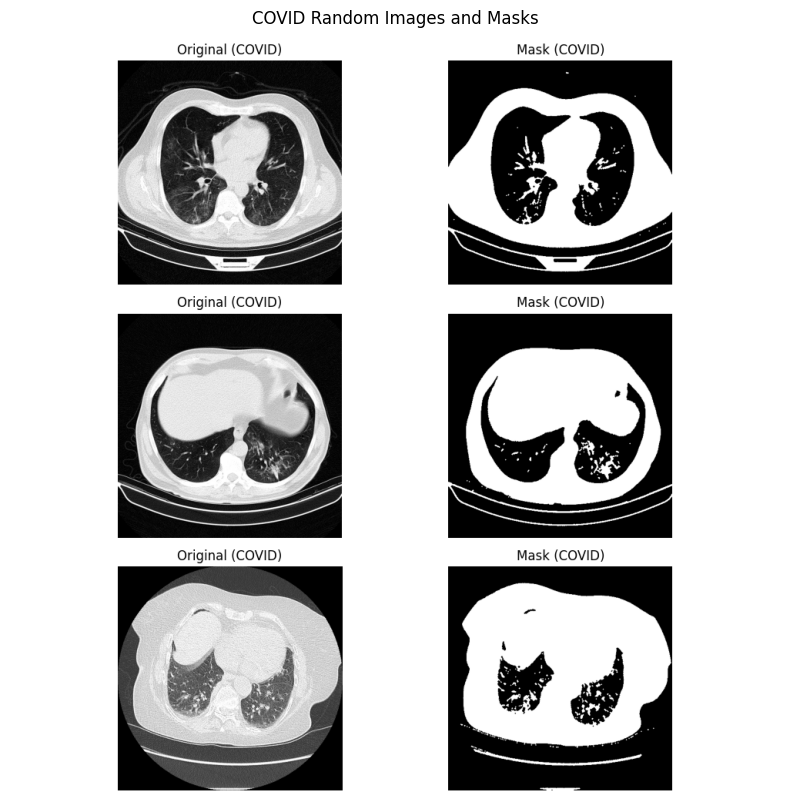

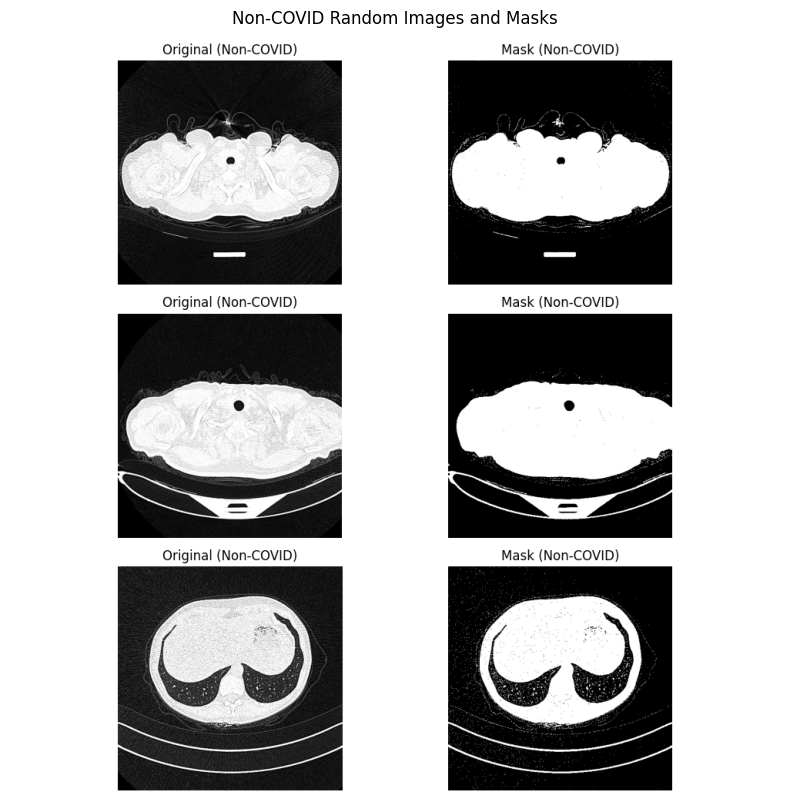

In [ ]:
# Function to display and save random images with their masks in a single image file
def save_random_images_with_masks(original_folder, mask_folder, output_filename, label, num_images=3):
    # List all image files in the original and mask folders
    original_files = os.listdir(original_folder)
    mask_files = os.listdir(mask_folder)

    # Randomly select images
    random_files = random.sample(original_files, min(num_images, len(original_files)))

    # Set up the plot for displaying images and their masks
    plt.figure(figsize=(10, 10))

    for i, filename in enumerate(random_files):
        original_path = os.path.join(original_folder, filename)
        mask_path = os.path.join(mask_folder, filename)

        # Load the original image and mask
        original_image = cv2.imread(original_path, cv2.IMREAD_GRAYSCALE)
        mask_image = cv2.imread(mask_path, cv2.IMREAD_GRAYSCALE)

        # Display original image
        plt.subplot(num_images, 2, 2 * i + 1)
        plt.imshow(original_image, cmap='gray')
        plt.title(f"Original ({label})")  # Add label to the title
        plt.axis('off')

        # Display mask image
        plt.subplot(num_images, 2, 2 * i + 2)
        plt.imshow(mask_image, cmap='gray')
        plt.title(f"Mask ({label})")  # Add label to the title
        plt.axis('off')

    plt.tight_layout()
    plt.savefig(output_filename)  # Save the figure as a single image file
    plt.close()  # Close the figure after saving to free up memory

# Save and display images for COVID folder
covid_output_file = 'COVID_random_images.png'
save_random_images_with_masks(covid_path, covid_mask_path, covid_output_file, label="COVID")
print("Saved random images and their masks from COVID folder.")

# Save and display images for Non-COVID folder
non_covid_output_file = 'Non_COVID_random_images.png'
save_random_images_with_masks(non_covid_path, non_covid_mask_path, non_covid_output_file, label="Non-COVID")
print("Saved random images and their masks from Non-COVID folder.")

# Display saved images
def display_saved_image(file_path, title):
    image = cv2.imread(file_path)
    image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)  # Convert BGR to RGB for matplotlib
    plt.figure(figsize=(10, 10))
    plt.imshow(image_rgb)
    plt.title(title)
    plt.axis('off')
    plt.show()

# Display the saved images for both folders
display_saved_image(covid_output_file, "COVID Random Images and Masks")
display_saved_image(non_covid_output_file, "Non-COVID Random Images and Masks")

In [ ]:
from concurrent.futures import ThreadPoolExecutor
from sklearn.mixture import GaussianMixture
from sklearn.cluster import KMeans
from skimage.metrics import structural_similarity as ssim

# Define input and output paths for images and masks
input_paths = {
    "COVID Images": '/content/drive/MyDrive/CT Lung Images/COVID',
    "Non-COVID Images": '/content/drive/MyDrive/CT Lung Images/Non COVID',
    "COVID Masks": '/content/drive/MyDrive/CT Lung Images/COVID mask',
    "Non-COVID Masks": '/content/drive/MyDrive/CT Lung Images/Non COVID mask'
}

output_paths = {
    "COVID Images Processed": '/content/drive/MyDrive/CT Lung Images/crop COVID Images',
    "Non-COVID Images Processed": '/content/drive/MyDrive/CT Lung Images/crop Non COVID Images',
    "COVID Masks Processed": '/content/drive/MyDrive/CT Lung Images/crop COVID Masks',
    "Non-COVID Masks Processed": '/content/drive/MyDrive/CT Lung Images/crop Non COVID Masks'
}

# Ensure output directories exist
for path in output_paths.values():
    os.makedirs(path, exist_ok=True)

# Function to crop from all sides
def crop_from_all_sides(image, top_ratio=0.15, bottom_ratio=0.15, left_ratio=0.15, right_ratio=0.15):
    try:
        height, width = image.shape[:2]
        top = int(height * top_ratio)
        bottom = int(height * bottom_ratio)
        left = int(width * left_ratio)
        right = int(width * right_ratio)

        cropped_image = image[top:height-bottom, left:width-right]
        return cropped_image
    except Exception as e:
        print(f"Error cropping the image: {e}")
        return None

# Function to resize image to 256x256
def resize_to_256x256(image):
    try:
        resized_image = cv2.resize(image, (256, 256), interpolation=cv2.INTER_AREA)
        return resized_image
    except Exception as e:
        print(f"Error resizing the image: {e}")
        return None

# Function to process an image: crop from all sides then resize
def process_image(image_path, output_path, top_ratio, bottom_ratio, left_ratio, right_ratio):
    try:
        image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)
        if image is not None:
            cropped = crop_from_all_sides(image, top_ratio, bottom_ratio, left_ratio, right_ratio)
            if cropped is not None:
                resized = resize_to_256x256(cropped)
                if resized is not None:
                    cv2.imwrite(output_path, resized)
    except Exception as e:
        print(f"Error processing image {image_path}: {e}")

# Function to process all images in a folder using parallel processing
def process_and_save_images_parallel(input_folder, output_folder, top_ratio, bottom_ratio, left_ratio, right_ratio):
    """
    Processes all images in the input folder, saves the processed images to the output folder using parallel processing.
    """
    image_files = [f for f in os.listdir(input_folder) if f.endswith(('.png', '.jpg', '.jpeg'))]
    image_paths = [os.path.join(input_folder, f) for f in image_files]
    output_paths = [os.path.join(output_folder, f) for f in image_files]

    with ThreadPoolExecutor() as executor:
        # Create tasks for each image
        tasks = [
            executor.submit(
                process_image, image_path, output_path, top_ratio, bottom_ratio, left_ratio, right_ratio
            )
            for image_path, output_path in zip(image_paths, output_paths)
        ]

        # Use tqdm to show progress
        for _ in tqdm(tasks, desc=f"Processing {input_folder}"):
            _.result()  # Ensure all tasks complete

# Function to validate folders
def validate_folders(input_folder, output_folder):
    input_files = [f for f in os.listdir(input_folder) if f.endswith(('.png', '.jpg', '.jpeg'))]
    output_files = [f for f in os.listdir(output_folder) if f.endswith(('.png', '.jpg', '.jpeg'))]
    return len(input_files), len(output_files)

# Main execution
if __name__ == "__main__":
    # Define cropping ratios
    top_ratio = 0.15  # Crop 15% from the top
    bottom_ratio = 0.15  # Crop 15% from the bottom
    left_ratio = 0.15  # Crop 15% from the left
    right_ratio = 0.15  # Crop 15% from the right

    # Process each folder
    for category, input_folder in input_paths.items():
        output_folder = output_paths[f"{category} Processed"]
        print(f"\nValidating category: {category}")

        input_count, output_count = validate_folders(input_folder, output_folder)

        if input_count == output_count:
            print(f"Skipping processing for {category}: {input_count} files already processed.")
        else:
            print(f"Processing {category}: {input_count} files in input, {output_count} files in output.")
            process_and_save_images_parallel(input_folder, output_folder, top_ratio, bottom_ratio, left_ratio, right_ratio)
            print(f"Processed images saved to: {output_folder}")



Validating category: COVID Images
Skipping processing for COVID Images: 10000 files already processed.

Validating category: Non-COVID Images
Skipping processing for Non-COVID Images: 10000 files already processed.

Validating category: COVID Masks
Skipping processing for COVID Masks: 10000 files already processed.

Validating category: Non-COVID Masks
Skipping processing for Non-COVID Masks: 10000 files already processed.


Loading COVID dataset...


Loading data from crop COVID Images: 100%|██████████| 10000/10000 [05:17<00:00, 31.45it/s]


Loaded 10000 images and masks from crop COVID Images
Loading Non-COVID dataset...


Loading data from crop Non COVID Images: 100%|██████████| 10000/10000 [05:34<00:00, 29.87it/s]


Loaded 10000 images and masks from crop Non COVID Images
Combining datasets...
Data loaded successfully!
Total images: 20000, Image size: (256, 256)
Total masks: 20000, Mask size: (256, 256)
Splitting data into training, validation, and testing sets...
Training set: 13999 images and 13999 masks
Validation set: 4000 images and 4000 masks
Testing set: 2001 images and 2001 masks


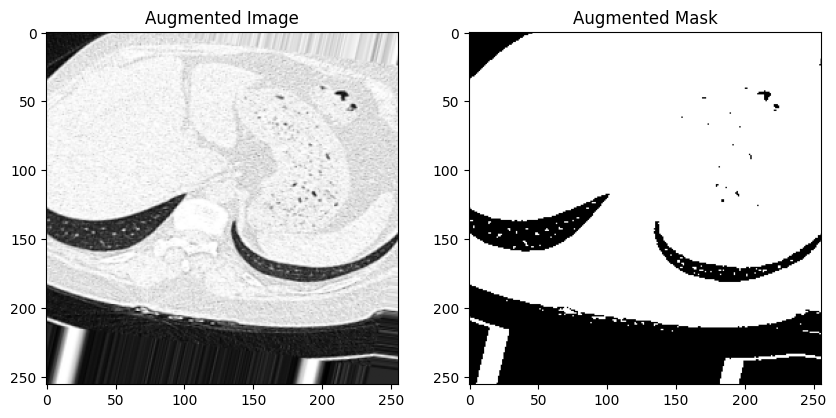

In [ ]:
# Import necessary libraries
from concurrent.futures import ThreadPoolExecutor
from sklearn.model_selection import train_test_split
from tensorflow.keras.preprocessing.image import ImageDataGenerator

# Define paths for input images and masks
covid_path = '/content/drive/MyDrive/CT Lung Images/crop COVID Images'
non_covid_path = '/content/drive/MyDrive/CT Lung Images/crop Non COVID Images'
covid_mask_path = '/content/drive/MyDrive/CT Lung Images/crop COVID Masks'
non_covid_mask_path = '/content/drive/MyDrive/CT Lung Images/crop Non COVID Masks'

# Function to load a single image and its mask
def load_image_and_mask(image_path, mask_path, target_size=(256, 256)):
    """
    Load and preprocess a single image and its corresponding mask.
    """
    image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)
    mask = cv2.imread(mask_path, cv2.IMREAD_GRAYSCALE)

    if image is not None and mask is not None:
        image = cv2.resize(image, target_size) / 255.0
        mask = cv2.resize(mask, target_size) / 255.0
        return image, mask
    else:
        return None, None

# Function to load all images and masks in parallel
def load_dataset(image_folder, mask_folder, target_size=(256, 256)):
    """
    Load and preprocess all images and masks in a folder in parallel.
    """
    image_files = sorted(os.listdir(image_folder))
    mask_files = sorted(os.listdir(mask_folder))

    assert len(image_files) == len(mask_files), "Mismatch between image and mask counts"

    images, masks = [], []
    with ThreadPoolExecutor() as executor:
        results = list(tqdm(
            executor.map(
                lambda x: load_image_and_mask(
                    os.path.join(image_folder, x[0]),
                    os.path.join(mask_folder, x[1]),
                    target_size
                ),
                zip(image_files, mask_files)
            ),
            total=len(image_files),
            desc=f"Loading data from {os.path.basename(image_folder)}"
        ))

    for img, msk in results:
        if img is not None and msk is not None:
            images.append(img)
            masks.append(msk)

    print(f"Loaded {len(images)} images and masks from {os.path.basename(image_folder)}")
    return np.array(images).reshape(-1, target_size[0], target_size[1], 1), \
           np.array(masks).reshape(-1, target_size[0], target_size[1], 1)

# Load COVID and Non-COVID datasets
print("Loading COVID dataset...")
covid_images, covid_masks = load_dataset(covid_path, covid_mask_path)
print("Loading Non-COVID dataset...")
non_covid_images, non_covid_masks = load_dataset(non_covid_path, non_covid_mask_path)

# Combine datasets
print("Combining datasets...")
X = np.concatenate([covid_images, non_covid_images], axis=0)
y = np.concatenate([covid_masks, non_covid_masks], axis=0)

# Display dataset details
print(f"Data loaded successfully!")
print(f"Total images: {X.shape[0]}, Image size: {X.shape[1:3]}")
print(f"Total masks: {y.shape[0]}, Mask size: {y.shape[1:3]}")

# Split data into training, validation, and testing sets
def split_data(X, y, train_size=0.7, val_size=0.2, test_size=0.1, random_state=42):
    """
    Split data into training, validation, and testing sets.
    """
    X_train, X_temp, y_train, y_temp = train_test_split(
        X, y, test_size=(1 - train_size), random_state=random_state
    )
    X_val, X_test, y_val, y_test = train_test_split(
        X_temp, y_temp, test_size=(test_size / (val_size + test_size)), random_state=random_state
    )

    return X_train, X_val, X_test, y_train, y_val, y_test

# Perform the split
print("Splitting data into training, validation, and testing sets...")
X_train, X_val, X_test, y_train, y_val, y_test = split_data(X, y)

print(f"Training set: {X_train.shape[0]} images and {y_train.shape[0]} masks")
print(f"Validation set: {X_val.shape[0]} images and {y_val.shape[0]} masks")
print(f"Testing set: {X_test.shape[0]} images and {y_test.shape[0]} masks")

# Data Augmentation for training dataset
def get_augmented_generator(images, masks, batch_size=32):
    """
    Apply data augmentation to images and masks while preserving binary masks.
    """
    data_gen_args = dict(
        rotation_range=20,
        width_shift_range=0.1,
        height_shift_range=0.1,
        zoom_range=0.2,
        horizontal_flip=True
    )

    image_datagen = ImageDataGenerator(**data_gen_args)
    mask_datagen = ImageDataGenerator(**data_gen_args)

    # Ensure masks remain binary
    def adjust_mask(mask):
        return (mask > 0.5).astype(np.float32)  # Thresholding to retain binary mask

    # Custom mask generator
    seed = 42
    image_generator = image_datagen.flow(images, batch_size=batch_size, seed=seed)
    mask_generator = mask_datagen.flow(masks, batch_size=batch_size, seed=seed)

    while True:
        img_batch = next(image_generator)
        mask_batch = next(mask_generator)
        mask_batch = np.array([adjust_mask(mask) for mask in mask_batch])
        yield img_batch, mask_batch

# Prepare augmented data generators for training
train_generator = get_augmented_generator(X_train, y_train, batch_size=32)

# Display augmentation example
aug_images, aug_masks = next(train_generator)
plt.figure(figsize=(10, 5))
plt.subplot(1, 2, 1)
plt.title("Augmented Image")
plt.imshow(aug_images[0].squeeze(), cmap='gray')
plt.subplot(1, 2, 2)
plt.title("Augmented Mask")
plt.imshow(aug_masks[0].squeeze(), cmap='gray')
plt.show()

In [ ]:
# # Import necessary libraries
# from tensorflow.keras.layers import Input, Conv2D, MaxPooling2D, Conv2DTranspose, concatenate, Activation, Multiply, Add, GlobalAveragePooling2D, Dense
# from tensorflow.keras.models import Model
# import tensorflow.keras.backend as K

# # SK Block
# def sk_block(x, filters):
#     """
#     Selective Kernel (SK) Block.
#     Parameters:
#     - x: Input tensor.
#     - filters: Number of filters for the convolution layers.
#     Returns:
#     - Output tensor after applying the SK block.
#     """
#     conv1 = Conv2D(filters, (3, 3), padding='same', activation='relu')(x)
#     conv2 = Conv2D(filters, (3, 3), padding='same', activation='relu')(conv1)

#     # Global Average Pooling for scaling
#     pooling = GlobalAveragePooling2D()(conv2)
#     dense1 = Dense(filters // 2, activation='relu')(pooling)
#     dense2 = Dense(filters, activation='sigmoid')(dense1)

#     # Scale the features
#     scaled = Multiply()([conv2, dense2])
#     return scaled


# # SKICU-Net model
# def skicu_net(input_shape=(256, 256, 1)):
#     """
#     Build the SKICU-Net model.
#     Parameters:
#     - input_shape: Shape of the input image (default: (256, 256, 1)).
#     Returns:
#     - Keras model.
#     """
#     # Input layer
#     inputs = Input(input_shape)

#     # Encoder path
#     c1 = sk_block(inputs, 64)
#     p1 = MaxPooling2D((2, 2))(c1)

#     c2 = sk_block(p1, 128)
#     p2 = MaxPooling2D((2, 2))(c2)

#     c3 = sk_block(p2, 256)
#     p3 = MaxPooling2D((2, 2))(c3)

#     c4 = sk_block(p3, 512)
#     p4 = MaxPooling2D((2, 2))(c4)

#     # Bottleneck
#     c5 = sk_block(p4, 1024)

#     # Decoder path
#     u4 = Conv2DTranspose(512, (2, 2), strides=(2, 2), padding='same')(c5)
#     u4 = concatenate([u4, c4])  # Skip connection
#     c6 = sk_block(u4, 512)

#     u3 = Conv2DTranspose(256, (2, 2), strides=(2, 2), padding='same')(c6)
#     u3 = concatenate([u3, c3])  # Skip connection
#     c7 = sk_block(u3, 256)

#     u2 = Conv2DTranspose(128, (2, 2), strides=(2, 2), padding='same')(c7)
#     u2 = concatenate([u2, c2])  # Skip connection
#     c8 = sk_block(u2, 128)

#     u1 = Conv2DTranspose(64, (2, 2), strides=(2, 2), padding='same')(c8)
#     u1 = concatenate([u1, c1])  # Skip connection
#     c9 = sk_block(u1, 64)

#     # Output layer
#     outputs = Conv2D(1, (1, 1), activation='sigmoid')(c9)

#     # Build the model
#     model = Model(inputs, outputs, name="SKICU-Net")
#     return model


# # Build and summarize the model
# print("Building SKICU-Net model...")
# model = skicu_net()

# # Display model summary
# model.summary()


In [ ]:
from tensorflow.keras.layers import Input, Conv2D, MaxPooling2D, Conv2DTranspose, concatenate, Multiply, GlobalAveragePooling2D, Dense
from tensorflow.keras.models import Model

# SK Block (مع تقليل عدد الطبقات الداخلية)
def sk_block(x, filters):
    conv1 = Conv2D(filters, (3, 3), padding='same', activation='relu')(x)

    # إزالة الطبقة الثانية لتبسيط الحسابات
    pooling = GlobalAveragePooling2D()(conv1)
    dense1 = Dense(filters // 4, activation='relu')(pooling)  # تقليل الوحدات
    dense2 = Dense(filters, activation='sigmoid')(dense1)

    scaled = Multiply()([conv1, dense2])
    return scaled

# SKICU-Net (مع تقليل عدد المرشحات والطبقات)
def skicu_net(input_shape=(256, 256, 1)):
    inputs = Input(input_shape)

    # تقليل عدد الفلاتر في كل مستوى
    c1 = sk_block(inputs, 32)
    p1 = MaxPooling2D((2, 2))(c1)

    c2 = sk_block(p1, 64)
    p2 = MaxPooling2D((2, 2))(c2)

    c3 = sk_block(p2, 128)  # لم نغير هذا المستوى
    p3 = MaxPooling2D((2, 2))(c3)

    c4 = Conv2D(256, (3, 3), padding='same', activation='relu')(p3)  # استبدال sk_block بطبقة Conv2D بسيطة
    p4 = MaxPooling2D((2, 2))(c4)

    c5 = sk_block(p4, 512)

    # Decoder Path
    u4 = Conv2DTranspose(256, (2, 2), strides=(2, 2), padding='same')(c5)
    u4 = concatenate([u4, c4])
    c6 = Conv2D(256, (3, 3), padding='same', activation='relu')(u4)  # استبدال sk_block بطبقة بسيطة

    u3 = Conv2DTranspose(128, (2, 2), strides=(2, 2), padding='same')(c6)
    u3 = concatenate([u3, c3])
    c7 = sk_block(u3, 128)

    u2 = Conv2DTranspose(64, (2, 2), strides=(2, 2), padding='same')(c7)
    u2 = concatenate([u2, c2])
    c8 = sk_block(u2, 64)

    u1 = Conv2DTranspose(32, (2, 2), strides=(2, 2), padding='same')(c8)
    u1 = concatenate([u1, c1])
    c9 = sk_block(u1, 32)

    outputs = Conv2D(1, (1, 1), activation='sigmoid')(c9)

    model = Model(inputs, outputs, name="SKICU-Net-Reduced")
    return model

# بناء النموذج وتلخيصه
print("Building Reduced SKICU-Net model...")
model = skicu_net()
model.summary()


Building Reduced SKICU-Net model...


Model: "SKICU-Net-Reduced"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)  │ (None, 256, 256, 1)    │              0 │ -                      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d (Conv2D)           │ (None, 256, 256, 32)   │            320 │ input_layer[0][0]      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ global_average_pooling2d  │ (None, 32)             │              0 │ conv2d[0][0]           │
│ (GlobalAveragePooling2D)  │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense (Dense)             │ (None, 8)              │            264 │ global_average_poolin… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_1 (Dense)           │ (None, 32)             │            288 │ dense[0][0]            │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ multiply (Multiply)       │ (None, 256, 256, 32)   │              0 │ conv2d[0][0],          │
│                           │                        │                │ dense_1[0][0]          │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ max_pooling2d             │ (None, 128, 128, 32)   │              0 │ multiply[0][0]         │
│ (MaxPooling2D)            │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_1 (Conv2D)         │ (None, 128, 128, 64)   │         18,496 │ max_pooling2d[0][0]    │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ global_average_pooling2d… │ (None, 64)             │              0 │ conv2d_1[0][0]         │
│ (GlobalAveragePooling2D)  │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_2 (Dense)           │ (None, 16)             │          1,040 │ global_average_poolin… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_3 (Dense)           │ (None, 64)             │          1,088 │ dense_2[0][0]          │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ multiply_1 (Multiply)     │ (None, 128, 128, 64)   │              0 │ conv2d_1[0][0],        │
│                           │                        │                │ dense_3[0][0]          │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ max_pooling2d_1           │ (None, 64, 64, 64)     │              0 │ multiply_1[0][0]       │
│ (MaxPooling2D)            │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_2 (Conv2D)         │ (None, 64, 64, 128)    │         73,856 │ max_pooling2d_1[0][0]  │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ global_average_pooling2d… │ (None, 128)            │              0 │ conv2d_2[0][0]         │
│ (GlobalAveragePooling2D)  │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_4 (Dense)           │ (None, 32)             │          4,128 │ global_average_poolin… │
├──────────────────────

 Total params: 3,985,809 (15.20 MB)

 Trainable params: 3,985,809 (15.20 MB)

 Non-trainable params: 0 (0.00 B)

In [ ]:
# # Install TensorBoard
# !pip install tensorboard

In [ ]:
# حساب عدد الطبقات في نموذج SKICU-Net
model = skicu_net()  # تأكد من أن دالة skicu_net() معرفة
num_layers = len(model.layers)

print(f"عدد طبقات النموذج: {num_layers}")


عدد طبقات النموذج: 51


In [ ]:
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import EarlyStopping, ReduceLROnPlateau
import tensorflow.keras.backend as K
import tensorflow as tf
import matplotlib.pyplot as plt
import numpy as np
import os

# Dice Loss function
def dice_loss(y_true, y_pred):
    """
    Calculate Dice Loss.
    Parameters:
    - y_true: Ground truth masks.
    - y_pred: Predicted masks.
    Returns:
    - Dice loss value.
    """
    numerator = 2 * tf.reduce_sum(y_true * y_pred)
    denominator = tf.reduce_sum(y_true + y_pred)
    return 1 - numerator / (denominator + tf.keras.backend.epsilon())

# دالة لحساب الدقة Accuracy
# def accuracy(y_true, y_pred):
#     """
#     حساب دقة النموذج.
#     """
#     y_pred = K.round(y_pred)  # تحويل القيم إلى 0 أو 1
#     correct_predictions = K.sum(K.equal(y_true, y_pred))  # عدد القيم الصحيحة
#     total_predictions = K.prod(K.shape(y_true))  # إجمالي عدد القيم
#     return correct_predictions / total_predictions

import tensorflow as tf
import tensorflow.keras.backend as K

def accuracy(y_true, y_pred):
    """
    حساب دقة النموذج من خلال مقارنة التوقعات بالحقيقة الأرضية.
    """
    y_pred = K.round(y_pred)  # تحويل القيم إلى 0 أو 1
    y_pred = K.cast(y_pred, tf.float32)  # تحويل y_pred إلى float32
    y_true = K.cast(y_true, tf.float32)  # تحويل y_true إلى float32

    # استخدام K.equal لمقارنة y_true و y_pred ثم تحويل النتيجة إلى tf.float32
    correct_predictions = K.sum(K.cast(K.equal(y_true, y_pred), tf.float32))  # تحويل النتيجة إلى float32

    # تحويل total_predictions إلى float32
    total_predictions = K.cast(K.prod(K.shape(y_true)), tf.float32)  # تحويل total_predictions إلى float32

    return correct_predictions / total_predictions



# Dice Coefficient as a metric
def dice_coefficient(y_true, y_pred):
    """
    Calculate Dice Coefficient.
    Parameters:
    - y_true: Ground truth masks.
    - y_pred: Predicted masks.
    Returns:
    - Dice coefficient value.
    """
    numerator = 2 * tf.reduce_sum(y_true * y_pred)
    denominator = tf.reduce_sum(y_true + y_pred)
    return numerator / (denominator + tf.keras.backend.epsilon())

# Intersection over Union (IoU) as a metric
def iou(y_true, y_pred):
    """
    Calculate Intersection over Union (IoU).
    Parameters:
    - y_true: Ground truth masks.
    - y_pred: Predicted masks.
    Returns:
    - IoU value.
    """
    intersection = tf.reduce_sum(y_true * y_pred)
    union = tf.reduce_sum(y_true + y_pred) - intersection
    return intersection / (union + tf.keras.backend.epsilon())

# Sensitivity (Recall)
def sensitivity(y_true, y_pred):
    true_positives = K.sum(K.round(K.clip(y_true * y_pred, 0, 1)))
    possible_positives = K.sum(K.round(K.clip(y_true, 0, 1)))
    return true_positives / (possible_positives + K.epsilon())

# Specificity
def specificity(y_true, y_pred):
    true_negatives = K.sum(K.round(K.clip((1 - y_true) * (1 - y_pred), 0, 1)))
    possible_negatives = K.sum(K.round(K.clip(1 - y_true, 0, 1)))
    return true_negatives / (possible_negatives + K.epsilon())

# Precision
def precision(y_true, y_pred):
    true_positives = K.sum(K.round(K.clip(y_true * y_pred, 0, 1)))
    predicted_positives = K.sum(K.round(K.clip(y_pred, 0, 1)))
    return true_positives / (predicted_positives + K.epsilon())

# F1-Score
def f1_score(y_true, y_pred):
    prec = precision(y_true, y_pred)
    rec = sensitivity(y_true, y_pred)
    return 2 * ((prec * rec) / (prec + rec + K.epsilon()))

# MaskLogger Callback for visualization
class MaskLogger(tf.keras.callbacks.Callback):
    def __init__(self, X_val, y_val, log_dir, num_samples=5):
        super().__init__()
        self.X_val = X_val
        self.y_val = y_val
        self.log_dir = log_dir
        self.num_samples = num_samples
        self.file_writer = tf.summary.create_file_writer(os.path.join(log_dir, "masks"))

    def on_epoch_end(self, epoch, logs=None):
        logs = logs or {}  # Ensure logs is not None
        indices = np.random.choice(len(self.X_val), self.num_samples, replace=False)

        with self.file_writer.as_default():
            for i, idx in enumerate(indices):
                x_sample = self.X_val[idx:idx+1]
                y_true_sample = self.y_val[idx]
                y_pred_sample = self.model.predict(x_sample)[0]

                # Plot Ground Truth and Predicted Mask
                fig, axes = plt.subplots(1, 2, figsize=(8, 4))
                axes[0].imshow(y_true_sample.squeeze(), cmap='gray')
                axes[0].set_title("Ground Truth Mask")
                axes[0].axis("off")

                axes[1].imshow(y_pred_sample.squeeze(), cmap='gray')
                axes[1].set_title("Predicted Mask")
                axes[1].axis("off")

                plt.tight_layout()
                # Save the figure in TensorBoard
                tf.summary.image(f"Validation Masks Sample {i}", self.plot_to_tensor(fig), step=epoch)

    def plot_to_tensor(self, fig):
        """Convert a Matplotlib figure to a TensorFlow image tensor."""
        fig.canvas.draw()
        img = np.frombuffer(fig.canvas.tostring_argb(), dtype=np.uint8)
        img = img.reshape(fig.canvas.get_width_height()[::-1] + (4,))  # ARGB يحتوي على 4 قنوات
        img = img[:, :, 1:]  # إزالة قناة Alpha لتحويل الصورة إلى RGB

        plt.close(fig)
        return np.expand_dims(img, 0)

In [ ]:
from tensorflow.keras.callbacks import EarlyStopping, ReduceLROnPlateau, TensorBoard
import time

# Define the compile and train function
def compile_and_train_model(model, train_generator, X_val, y_val, log_dir, batch_size=32, epochs=5):
    """
    Compile and train the SKICU-Net model.
    """
    # Compile the model
    model.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=1e-4),
    loss=dice_loss,
    metrics=[accuracy, dice_coefficient, iou, f1_score, sensitivity, specificity]
    )

    # Define callbacks
    callbacks = [
        EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True, verbose=1),
        ReduceLROnPlateau(monitor='val_loss', factor=0.2, patience=5, min_lr=1e-6, verbose=1),
        TensorBoard(log_dir=log_dir, histogram_freq=1, write_images=True),
        MaskLogger(X_val, y_val, log_dir=log_dir, num_samples=5)
    ]

    # Start training
    print("Model is ready for training!")
    history = model.fit(
        train_generator,
        validation_data=(X_val, y_val),
        epochs=epochs,
        batch_size=batch_size,
        callbacks=callbacks,
        verbose=1
    )

    return history


In [ ]:
# !pip uninstall tensorflow tensorflow-gpu -y
# !pip install tensorflow

In [ ]:
# from tensorflow.keras.callbacks import EarlyStopping, ReduceLROnPlateau, TensorBoard
# import time
# import datetime

# # تحديد دليل تسجيل TensorBoard
# log_dir = "logs/fit/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S")

# # تجميع النموذج
# model.compile(
#     optimizer=tf.keras.optimizers.Adam(learning_rate=1e-4),  # معدل التعلم
#     loss=dice_loss,  # دالة الخسارة
#     metrics=[accuracy, dice_coefficient, iou, f1_score, sensitivity, specificity]  # المقاييس
# )

# # بدء تتبع الزمن
# start_time = time.time()

# # تعريف Callbacks لتحسين التدريب
# callbacks = [
#     EarlyStopping(monitor='val_loss', patience=3, restore_best_weights=True, verbose=1),  # إيقاف مبكر بعد 3 تكرارات متتالية دون تحسن
#     ReduceLROnPlateau(monitor='val_loss', factor=0.2, patience=2, min_lr=1e-6, verbose=1),  # تقليل معدل التعلم عند ثبات الأداء
#     TensorBoard(log_dir=log_dir, histogram_freq=1, write_images=True),  # تسجيل الأداء في TensorBoard
#     MaskLogger(X_val, y_val, log_dir=log_dir, num_samples=5)  # تسجيل بعض النتائج للتحليل
# ]

# # بدء التدريب
# print("🚀 بدء تدريب النموذج مع Early Stopping (بعد 3 تكرارات متتالية)...")
# history = model.fit(
#     X_train, y_train,                # بيانات التدريب
#     validation_data=(X_val, y_val),  # بيانات التحقق
#     epochs=5,                        # عدد التكرارات
#     batch_size=32,                   # حجم الدُفعة
#     callbacks=callbacks,              # استدعاءات التحسين
#     verbose=1
# )

# # حساب الزمن المستغرق في التدريب
# total_time = time.time() - start_time
# print(f"✅ تم الانتهاء من التدريب في {total_time / 60:.2f} دقيقة.")


In [ ]:
import tensorflow as tf
import matplotlib.pyplot as plt
import numpy as np
import io
import time
import datetime

# تحديد دليل تسجيل TensorBoard
log_dir = "logs/fit/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S")

# إعداد الخط الافتراضي
plt.rcParams.update({
    "font.size": 16,  # حجم الخط ليكون متناسقًا مع وورد
    "axes.titlesize": 16,
    "axes.labelsize": 16,
    "xtick.labelsize": 14,
    "ytick.labelsize": 14,
    "legend.fontsize": 14
})

# تجميع النموذج
model.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=1e-4),
    loss=dice_loss,
    metrics=[accuracy, dice_coefficient, iou, f1_score, sensitivity, specificity]
)

# بدء تتبع الزمن
start_time = time.time()

# إعداد سجل الملفات لـ TensorBoard
file_writer = tf.summary.create_file_writer(log_dir)

# دالة لتحويل المخططات إلى صور
def plot_to_image(fig):
    """تحويل مخطط matplotlib إلى صورة TensorFlow"""
    buf = io.BytesIO()
    fig.savefig(buf, format="png", dpi=300)  # دقة عالية للطباعة في وورد
    buf.seek(0)
    image = tf.image.decode_png(buf.getvalue(), channels=4)
    image = tf.expand_dims(image, 0)
    return image

# دالة لحفظ جميع المقاييس كمخططات صور في TensorBoard
def log_all_metrics_as_images(epoch, logs):
    """تسجيل جميع المقاييس كمخططات صور في TensorBoard"""
    fig, ax = plt.subplots(2, 4, figsize=(20, 10))  # شبكة 2x4 لعرض جميع المقاييس

    metrics = ["loss", "accuracy", "dice_coefficient", "iou", "f1_score", "sensitivity", "specificity"]

    for i, metric in enumerate(metrics):
        row, col = divmod(i, 4)
        ax[row, col].plot(range(1, epoch+1), logs[metric][:epoch], label=f"Training {metric}", color="blue", linewidth=2)
        ax[row, col].plot(range(1, epoch+1), logs[f"val_{metric}"][:epoch], label=f"Validation {metric}", color="red", linewidth=2)
        ax[row, col].set_xlabel("Epoch", fontsize=16)
        ax[row, col].set_ylabel(metric, fontsize=16)
        ax[row, col].set_title(metric, fontsize=16, fontweight='bold')
        ax[row, col].legend()

    # إزالة أي رسوم فارغة
    for i in range(len(metrics), 8):
        row, col = divmod(i, 4)
        fig.delaxes(ax[row, col])

    plt.tight_layout()

    # تحويل الرسم إلى صورة وتسجيلها في TensorBoard
    image = plot_to_image(fig)
    with file_writer.as_default():
        tf.summary.image("Training Metrics", image, step=epoch)

    plt.close(fig)

# إنشاء Callback لحفظ المقاييس كصور
class MetricsImageCallback(tf.keras.callbacks.Callback):
    def __init__(self, logs):
        self.logs = logs

    def on_epoch_end(self, epoch, logs=None):
        logs = logs or {}
        for key in logs:
            if key not in self.logs:
                self.logs[key] = []
            self.logs[key].append(logs[key])
        log_all_metrics_as_images(epoch+1, self.logs)

# حفظ السجلات
logs_history = {}

# تعريف Callbacks مع تسجيل المقاييس كصور
callbacks = [
    EarlyStopping(monitor='val_loss', patience=3, restore_best_weights=True, verbose=1),
    ReduceLROnPlateau(monitor='val_loss', factor=0.2, patience=2, min_lr=1e-6, verbose=1),
    TensorBoard(log_dir=log_dir, histogram_freq=1, write_images=True),
    MetricsImageCallback(logs_history)
]

# بدء التدريب
print("🚀 بدء تدريب النموذج مع تسجيل المقاييس كصور في TensorBoard...")
history = model.fit(
    X_train, y_train,
    validation_data=(X_val, y_val),
    epochs=20,
    batch_size=32,
    callbacks=callbacks,
    verbose=1
)

# حساب الزمن المستغرق في التدريب
total_time = time.time() - start_time
print(f"✅ تم الانتهاء من التدريب في {total_time / 60:.2f} دقيقة.")
print(f"✅ تم حفظ جميع المقاييس كصور في {log_dir}. يمكنك عرضها في TensorBoard.")


🚀 بدء تدريب النموذج مع تسجيل المقاييس كصور في TensorBoard...
Epoch 1/20
438/438 ━━━━━━━━━━━━━━━━━━━━ 1885s 4s/step - accuracy: 0.6293 - dice_coefficient: 0.7150 - f1_score: 0.7668 - iou: 0.5794 - loss: 0.2850 - sensitivity: 0.9632 - specificity: 0.2401 - val_accuracy: 0.9024 - val_dice_coefficient: 0.9552 - val_f1_score: 0.9579 - val_iou: 0.9143 - val_loss: 0.0448 - val_sensitivity: 0.9410 - val_specificity: 0.9686 - learning_rate: 1.0000e-04
Epoch 2/20
438/438 ━━━━━━━━━━━━━━━━━━━━ 1874s 4s/step - accuracy: 0.9044 - dice_coefficient: 0.9579 - f1_score: 0.9605 - iou: 0.9192 - loss: 0.0421 - sensitivity: 0.9486 - specificity: 0.9643 - val_accuracy: 0.9107 - val_dice_coefficient: 0.9645 - val_f1_score: 0.9672 - val_iou: 0.9314 - val_loss: 0.0355 - val_sensitivity: 0.9643 - val_specificity: 0.9603 - learning_rate: 1.0000e-04
Epoch 3/20
438/438 ━━━━━━━━━━━━━━━━━━━━ 1873s 4s/step - accuracy: 0.9125 - dice_coefficient: 0.9667 - f1_score: 0.9694 - iou: 0.9355 - loss: 0.0333 - sensitivity: 0.96

In [ ]:
# Run TensorBoard
%load_ext tensorboard
%tensorboard --logdir logs/fit

<IPython.core.display.Javascript object>

In [ ]:
import os

# مسار إضافي لحفظ الصور فعليًا
save_image_dir = "saved_metric_images"
os.makedirs(save_image_dir, exist_ok=True)

# تحديث دالة log_all_metrics_as_images لتقوم بالحفظ كصور أيضًا
def log_all_metrics_as_images(epoch, logs):
    """تسجيل جميع المقاييس كمخططات صور في TensorBoard وحفظها كصور على القرص"""
    fig, ax = plt.subplots(2, 4, figsize=(20, 10))  # شبكة 2x4 لعرض جميع المقاييس

    metrics = ["loss", "accuracy", "dice_coefficient", "iou", "f1_score", "sensitivity", "specificity"]

    for i, metric in enumerate(metrics):
        row, col = divmod(i, 4)
        ax[row, col].plot(range(1, epoch+1), logs[metric][:epoch], label=f"Training {metric}", color="blue", linewidth=2)
        ax[row, col].plot(range(1, epoch+1), logs[f"val_{metric}"][:epoch], label=f"Validation {metric}", color="red", linewidth=2)
        ax[row, col].set_xlabel("Epoch", fontsize=16)
        ax[row, col].set_ylabel(metric, fontsize=16)
        ax[row, col].set_title(metric, fontsize=16, fontweight='bold')
        ax[row, col].legend()

    for i in range(len(metrics), 8):
        row, col = divmod(i, 4)
        fig.delaxes(ax[row, col])

    plt.tight_layout()

    # 🔁 حفظ الصورة كـ PNG على القرص
    image_path = os.path.join(save_image_dir, f"epoch_{epoch:02d}_metrics.png")
    fig.savefig(image_path, dpi=300)
    print(f"🖼️ تم حفظ صورة المقاييس للحقبة {epoch} في: {image_path}")

    # 🧠 رفعها إلى TensorBoard أيضًا
    image = plot_to_image(fig)
    with file_writer.as_default():
        tf.summary.image("Training Metrics", image, step=epoch)

    plt.close(fig)


Model was trained in the current session. Proceeding to evaluation and plotting.
Training completed in 630.67 minutes.
Evaluating on validation set...
125/125 ━━━━━━━━━━━━━━━━━━━━ 89s 709ms/step - accuracy: 0.9226 - dice_coefficient: 0.9826 - f1_score: 0.9886 - iou: 0.9658 - loss: 0.0174 - sensitivity: 0.9884 - specificity: 0.9847

Validation Results:
loss: 0.0176
compile_metrics: 0.9216


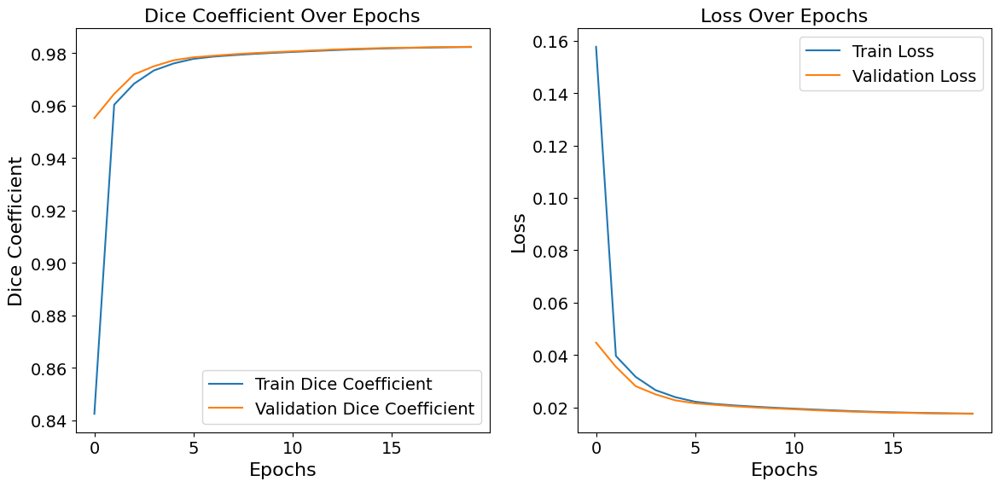

In [ ]:
# Check if the model is already trained in the current session
if 'history' in locals() and history is not None:
    print("Model was trained in the current session. Proceeding to evaluation and plotting.")
    trained_in_current_session = True
else:
    print("Model loaded from storage. Skipping training-dependent tasks.")
    trained_in_current_session = False

# Execute evaluation and plotting only if the model was trained in the session
if trained_in_current_session:
    # Calculate total training time
    total_time = time.time() - start_time
    print(f"Training completed in {total_time / 60:.2f} minutes.")

    # Evaluate the model on the validation set
    print("Evaluating on validation set...")
    results = model.evaluate(X_val, y_val, verbose=1)
    val_metrics = dict(zip(model.metrics_names, results))

    # Print evaluation results
    print("\nValidation Results:")
    for metric_name, value in val_metrics.items():
        print(f"{metric_name}: {value:.4f}")

    # Save the training history
    training_history = history.history

    # Plot training and validation metrics
    import matplotlib.pyplot as plt

    plt.figure(figsize=(12, 6))

    # Plot Dice Coefficient
    plt.subplot(1, 2, 1)
    if 'dice_coefficient' in training_history:
        plt.plot(training_history['dice_coefficient'], label='Train Dice Coefficient')
        plt.plot(training_history['val_dice_coefficient'], label='Validation Dice Coefficient')
        plt.title('Dice Coefficient Over Epochs')
        plt.xlabel('Epochs')
        plt.ylabel('Dice Coefficient')
        plt.legend()
    else:
        print("Dice Coefficient metric not found in history.")

    # Plot Loss
    plt.subplot(1, 2, 2)
    plt.plot(training_history['loss'], label='Train Loss')
    plt.plot(training_history['val_loss'], label='Validation Loss')
    plt.title('Loss Over Epochs')
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.legend()

    plt.tight_layout()
    plt.show()

else:
    print("Skipping evaluation and metric plotting as the model was not trained in this session.")


Training completed in 632.21 minutes.
Evaluating on validation set...
125/125 ━━━━━━━━━━━━━━━━━━━━ 87s 693ms/step - accuracy: 0.9226 - dice_coefficient: 0.9826 - f1_score: 0.9886 - iou: 0.9658 - loss: 0.0174 - sensitivity: 0.9884 - specificity: 0.9847

Validation Results:
loss: 0.0176
compile_metrics: 0.9216
📁 تم حفظ الرسم في الملف: training_metrics.png


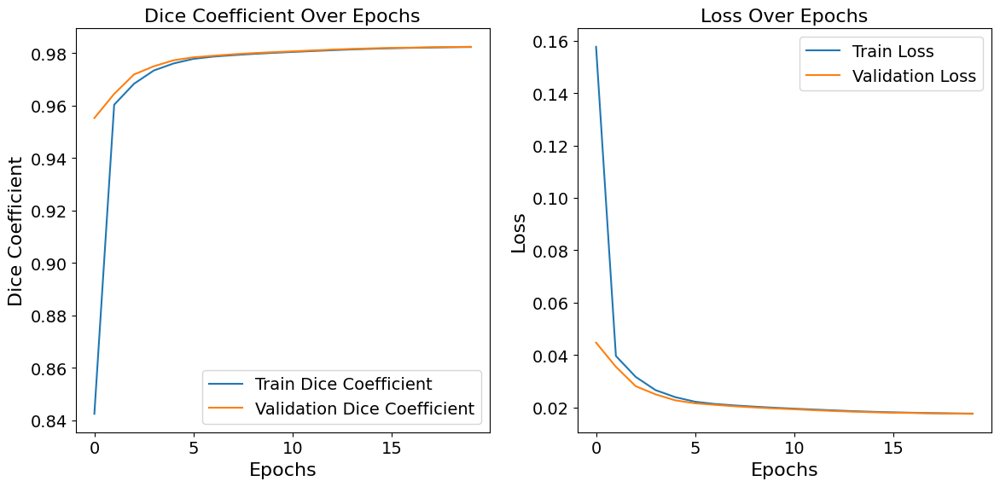

In [ ]:
# import matplotlib.pyplot as plt

# if trained_in_current_session:
#     total_time = time.time() - start_time
#     print(f"Training completed in {total_time / 60:.2f} minutes.")

#     print("Evaluating on validation set...")
#     results = model.evaluate(X_val, y_val, verbose=1)
#     val_metrics = dict(zip(model.metrics_names, results))

#     print("\nValidation Results:")
#     for metric_name, value in val_metrics.items():
#         print(f"{metric_name}: {value:.4f}")

#     training_history = history.history

#     # إعداد الرسم
#     plt.rcParams.update({
#         'font.size': 16,
#         'axes.titlesize': 16,
#         'axes.labelsize': 16,
#         'xtick.labelsize': 14,
#         'ytick.labelsize': 14,
#         'legend.fontsize': 14
#     })

#     fig = plt.figure(figsize=(12, 6))

#     # Dice Coefficient
#     ax1 = fig.add_subplot(1, 2, 1)
#     if 'dice_coefficient' in training_history:
#         ax1.plot(training_history['dice_coefficient'], label='Train Dice Coefficient')
#         ax1.plot(training_history['val_dice_coefficient'], label='Validation Dice Coefficient')
#         ax1.set_title('Dice Coefficient Over Epochs')
#         ax1.set_xlabel('Epochs')
#         ax1.set_ylabel('Dice Coefficient')
#         ax1.legend()
#     else:
#         print("Dice Coefficient metric not found in history.")

#     # Loss
#     ax2 = fig.add_subplot(1, 2, 2)
#     ax2.plot(training_history['loss'], label='Train Loss')
#     ax2.plot(training_history['val_loss'], label='Validation Loss')
#     ax2.set_title('Loss Over Epochs')
#     ax2.set_xlabel('Epochs')
#     ax2.set_ylabel('Loss')
#     ax2.legend()

#     plt.tight_layout()

#     # حفظ الشكل كصورة
#     fig.savefig("training_metrics.png", dpi=300)
#     print("📁 تم حفظ الرسم في الملف: training_metrics.png")

#     plt.show()

# else:
#     print("Skipping evaluation and metric plotting as the model was not trained in this session.")


Training completed in 670.29 minutes.
Evaluating on validation set...
125/125 ━━━━━━━━━━━━━━━━━━━━ 86s 689ms/step - accuracy: 0.9226 - dice_coefficient: 0.9826 - iou: 0.9658 - loss: 0.0174

Validation Results:
loss: 0.0176
compile_metrics: 0.9216
📁 تم حفظ الرسم: dice_coefficient.png


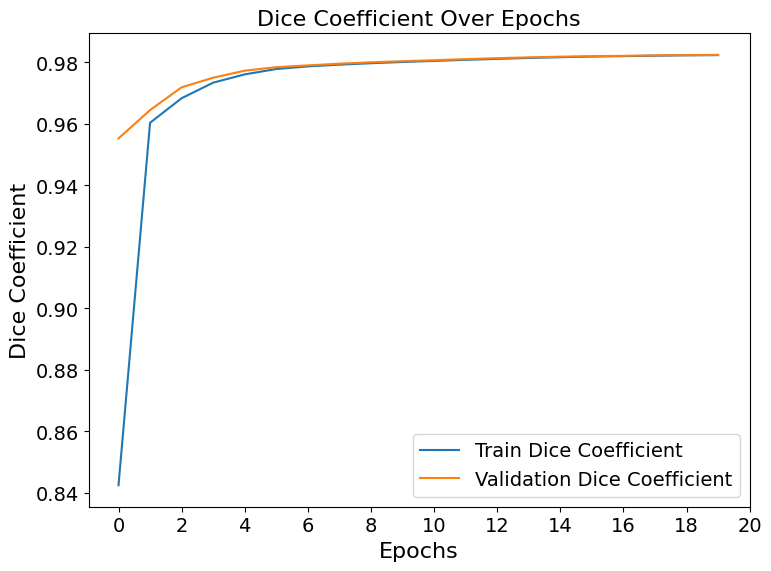

📁 تم حفظ الرسم: loss.png


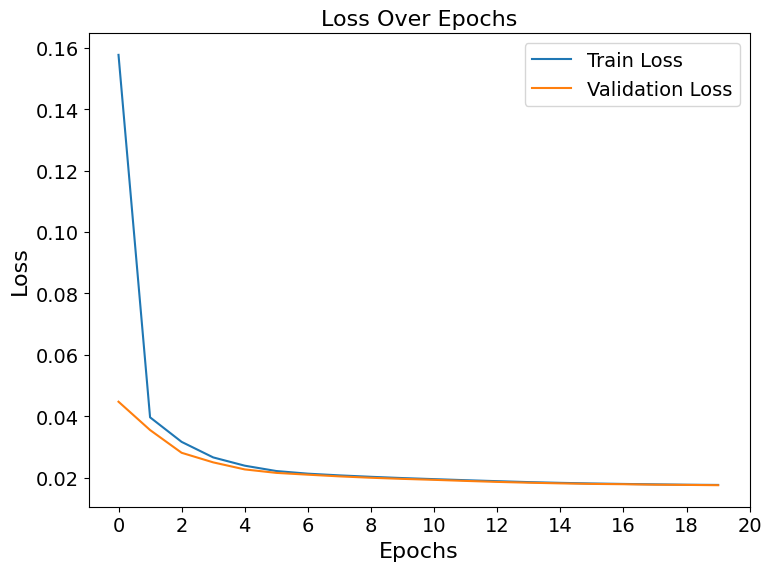

In [ ]:
import matplotlib.pyplot as plt

if trained_in_current_session:
    total_time = time.time() - start_time
    print(f"Training completed in {total_time / 60:.2f} minutes.")

    print("Evaluating on validation set...")
    results = model.evaluate(X_val, y_val, verbose=1)
    val_metrics = dict(zip(model.metrics_names, results))

    print("\nValidation Results:")
    for metric_name, value in val_metrics.items():
        print(f"{metric_name}: {value:.4f}")

    training_history = history.history

    # إعداد الخطوط العامة
    plt.rcParams.update({
        'font.size': 16,
        'axes.titlesize': 16,
        'axes.labelsize': 16,
        'xtick.labelsize': 14,
        'ytick.labelsize': 14,
        'legend.fontsize': 14
    })

    # توليد القيم الزوجية لمحور x
    epochs = len(training_history['loss'])
    even_ticks = list(range(0, epochs + 1, 2))

    # Dice Coefficient
    if 'dice_coefficient' in training_history:
        fig_dice = plt.figure(figsize=(8, 6))
        plt.plot(training_history['dice_coefficient'], label='Train Dice Coefficient')
        plt.plot(training_history['val_dice_coefficient'], label='Validation Dice Coefficient')
        plt.title('Dice Coefficient Over Epochs')
        plt.xlabel('Epochs')
        plt.ylabel('Dice Coefficient')
        plt.xticks(ticks=even_ticks)
        plt.legend()
        plt.tight_layout()
        fig_dice.savefig("dice_coefficient.png", dpi=300)
        print("📁 تم حفظ الرسم: dice_coefficient.png")
        plt.show()
    else:
        print("⚠️ Dice Coefficient metric not found in history.")

    # Loss
    fig_loss = plt.figure(figsize=(8, 6))
    plt.plot(training_history['loss'], label='Train Loss')
    plt.plot(training_history['val_loss'], label='Validation Loss')
    plt.title('Loss Over Epochs')
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.xticks(ticks=even_ticks)
    plt.legend()
    plt.tight_layout()
    fig_loss.savefig("loss.png", dpi=300)
    print("📁 تم حفظ الرسم: loss.png")
    plt.show()

else:
    print("⚠️ Skipping evaluation and metric plotting as the model was not trained in this session.")


In [ ]:
# Evaluate on test data
print("Evaluating the model on test data...")
test_results = model.evaluate(X_test, y_test, batch_size=32, verbose=1)

# Map test results to metric names for better readability
test_metrics = dict(zip(model.metrics_names, test_results))

# Print results
print("\nTest Results:")
for metric_name, value in test_metrics.items():
    print(f"{metric_name}: {value:.4f}")


Evaluating the model on test data...
63/63 ━━━━━━━━━━━━━━━━━━━━ 47s 725ms/step - accuracy: 0.9205 - dice_coefficient: 0.9822 - f1_score: 0.9885 - iou: 0.9651 - loss: 0.0178 - sensitivity: 0.9882 - specificity: 0.9844

Test Results:
loss: 0.0177
compile_metrics: 0.9204


📁 تم حفظ الرسم: iou.png


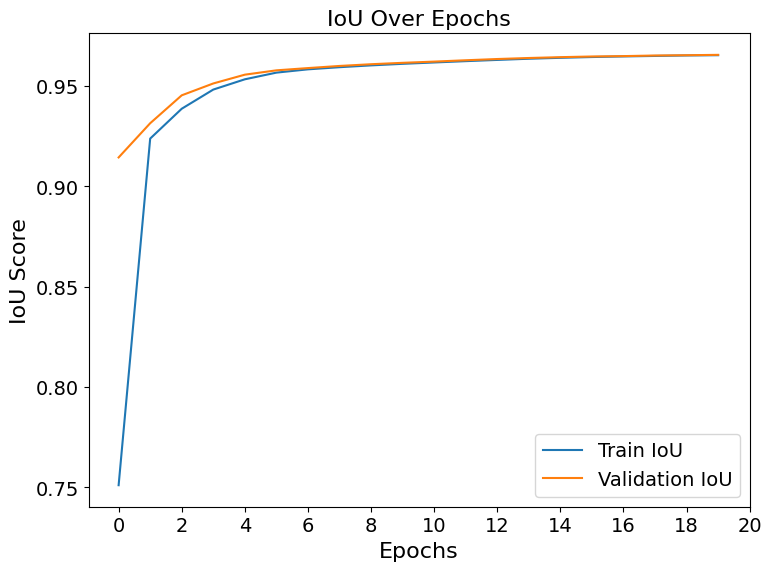

In [ ]:
import matplotlib.pyplot as plt

# تحديث إعدادات الرسم
plt.rcParams.update({
    'font.size': 16,
    'axes.titlesize': 16,
    'axes.labelsize': 16,
    'xtick.labelsize': 14,
    'ytick.labelsize': 14,
    'legend.fontsize': 14
})

# التحقق من وجود IoU في history
if 'iou' in history.history:
    fig = plt.figure(figsize=(8, 6))

    epochs = len(history.history['iou'])
    even_ticks = list(range(0, epochs + 1, 2))

    plt.plot(history.history['iou'], label='Train IoU')
    plt.plot(history.history['val_iou'], label='Validation IoU')
    plt.xlabel('Epochs')
    plt.ylabel('IoU Score')
    plt.title('IoU Over Epochs')
    plt.xticks(ticks=even_ticks)
    plt.legend()
    plt.tight_layout()

    fig.savefig("iou.png", dpi=300)
    print("📁 تم حفظ الرسم: iou.png")
    plt.show()
else:
    print("⚠️ IoU غير موجود في history. تم تجاوز الرسم.")


In [ ]:
# # تقييم النموذج على بيانات الاختبار
# print("Evaluating the model on test data...")
# test_results = model.evaluate(X_test, y_test, verbose=1)

# # عرض نتائج التقييم مع الدقة
# test_metrics = dict(zip(model.metrics_names, test_results))
# print("\nTest Results Summary:")
# for metric_name, value in test_metrics.items():
#     print(f"{metric_name}: {value:.4f}")


In [ ]:
# # Check if metrics exist in history before plotting
# if 'sensitivity' in history.history and 'specificity' in history.history:
#     plt.figure(figsize=(12, 6))

#     # Sensitivity and Specificity
#     plt.plot(history.history['sensitivity'], label='Train Sensitivity')
#     plt.plot(history.history['val_sensitivity'], label='Validation Sensitivity')
#     plt.plot(history.history['specificity'], label='Train Specificity')
#     plt.plot(history.history['val_specificity'], label='Validation Specificity')
#     plt.xlabel('Epochs')
#     plt.ylabel('Score')
#     plt.legend()
#     plt.title('Sensitivity and Specificity over Epochs')
#     plt.show()
# else:
#     print("Sensitivity or Specificity metrics not found in history. Skipping plot.")

# # Check if F1-Score exists in history before plotting
# if 'f1_score'in history.history:
#     plt.figure(figsize=(8, 6))

#     # F1-Score
#     plt.plot(history.history['f1_score'], label='Train F1-Score')
#     plt.plot(history.history['val_f1_score'], label='Validation F1-Score')
#     plt.xlabel('Epochs')
#     plt.ylabel('Score')
#     plt.legend()
#     plt.title('F1-Score over Epochs')
#     plt.show()
# else:
#     print("F1-Score metric not found in history. Skipping plot.")


📁 تم حفظ الرسم: sensitivity_specificity.png


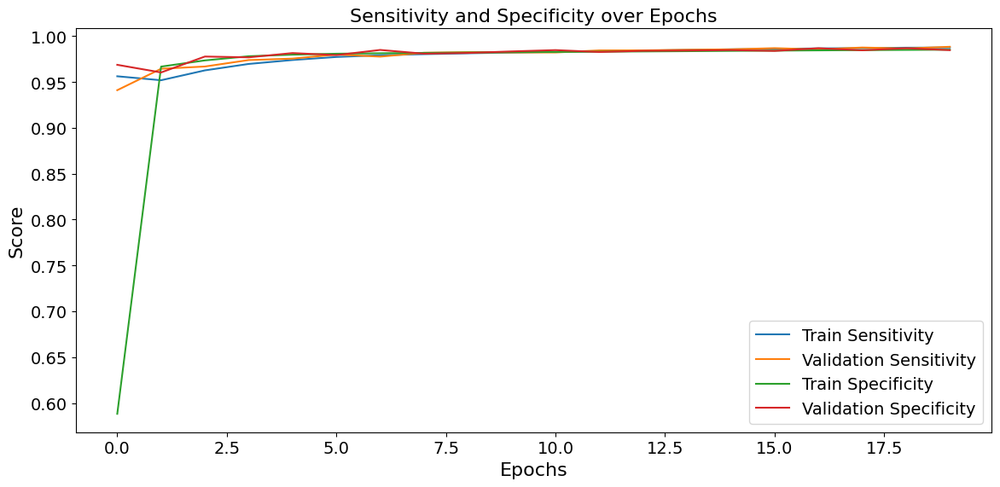

📁 تم حفظ الرسم: f1_score.png


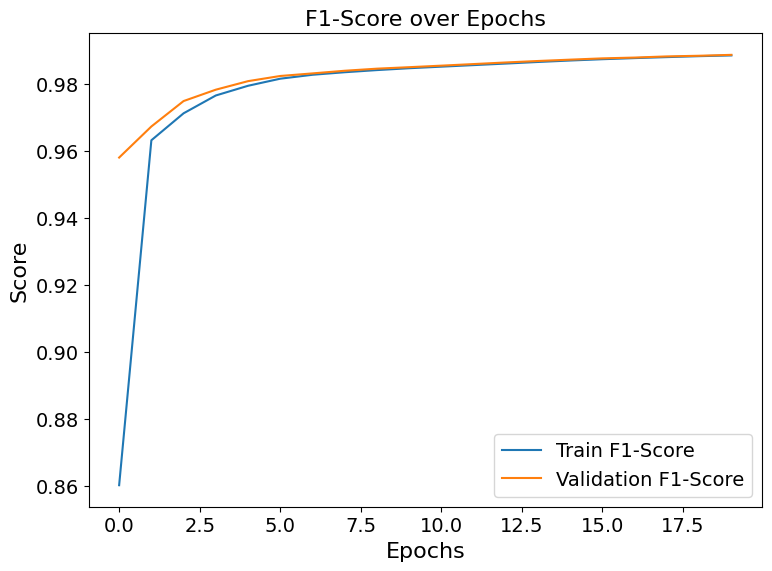

In [ ]:
# import matplotlib.pyplot as plt

# # إعداد الخطوط
# plt.rcParams.update({
#     'font.size': 16,
#     'axes.titlesize': 16,
#     'axes.labelsize': 16,
#     'xtick.labelsize': 14,
#     'ytick.labelsize': 14,
#     'legend.fontsize': 14
# })

# # رسم وحفظ Sensitivity و Specificity
# if 'sensitivity' in history.history and 'specificity' in history.history:
#     fig = plt.figure(figsize=(12, 6))

#     plt.plot(history.history['sensitivity'], label='Train Sensitivity')
#     plt.plot(history.history['val_sensitivity'], label='Validation Sensitivity')
#     plt.plot(history.history['specificity'], label='Train Specificity')
#     plt.plot(history.history['val_specificity'], label='Validation Specificity')

#     plt.xlabel('Epochs')
#     plt.ylabel('Score')
#     plt.legend()
#     plt.title('Sensitivity and Specificity over Epochs')

#     plt.tight_layout()
#     fig.savefig("sensitivity_specificity.png", dpi=300)
#     print("📁 تم حفظ الرسم: sensitivity_specificity.png")
#     plt.show()
# else:
#     print("⚠️ Sensitivity أو Specificity غير موجودة في history. تم تجاوز الرسم.")

# # رسم وحفظ F1-Score
# if 'f1_score' in history.history:
#     fig = plt.figure(figsize=(8, 6))

#     plt.plot(history.history['f1_score'], label='Train F1-Score')
#     plt.plot(history.history['val_f1_score'], label='Validation F1-Score')

#     plt.xlabel('Epochs')
#     plt.ylabel('Score')
#     plt.legend()
#     plt.title('F1-Score over Epochs')

#     plt.tight_layout()
#     fig.savefig("f1_score.png", dpi=300)
#     print("📁 تم حفظ الرسم: f1_score.png")
#     plt.show()
# else:
#     print("⚠️ F1-Score غير موجودة في history. تم تجاوز الرسم.")


📁 تم حفظ الرسم: sensitivity_specificity.png


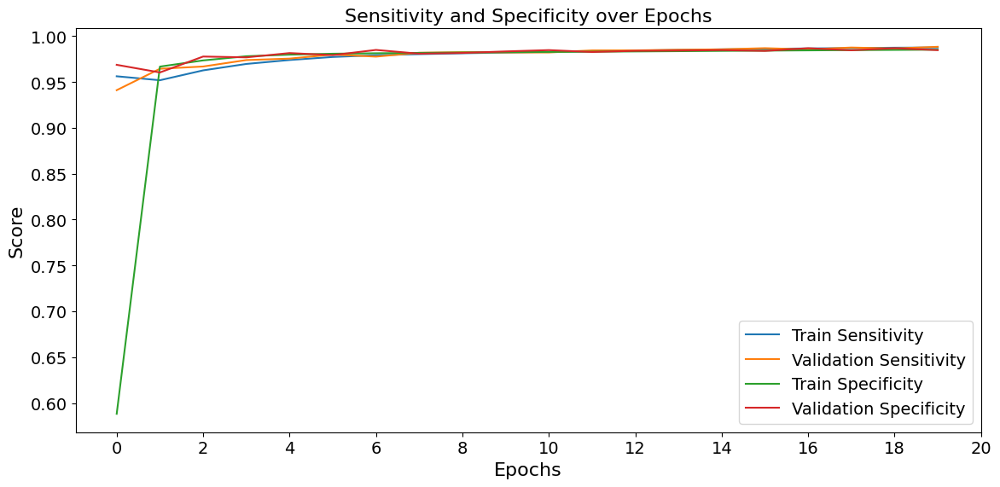

📁 تم حفظ الرسم: f1_score.png


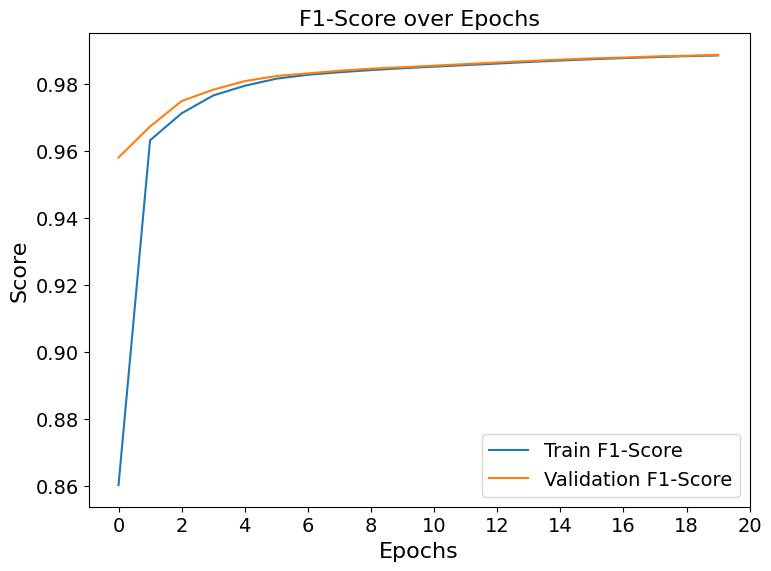

In [ ]:
import matplotlib.pyplot as plt

# إعداد الخطوط
plt.rcParams.update({
    'font.size': 16,
    'axes.titlesize': 16,
    'axes.labelsize': 16,
    'xtick.labelsize': 14,
    'ytick.labelsize': 14,
    'legend.fontsize': 14
})

# رسم وحفظ Sensitivity و Specificity
if 'sensitivity' in history.history and 'specificity' in history.history:
    fig = plt.figure(figsize=(12, 6))

    epochs = len(history.history['sensitivity'])
    even_ticks = list(range(0, epochs + 1, 2))

    plt.plot(history.history['sensitivity'], label='Train Sensitivity')
    plt.plot(history.history['val_sensitivity'], label='Validation Sensitivity')
    plt.plot(history.history['specificity'], label='Train Specificity')
    plt.plot(history.history['val_specificity'], label='Validation Specificity')

    plt.xlabel('Epochs')
    plt.ylabel('Score')
    plt.legend()
    plt.title('Sensitivity and Specificity over Epochs')
    plt.xticks(ticks=even_ticks)

    plt.tight_layout()
    fig.savefig("sensitivity_specificity.png", dpi=300)
    print("📁 تم حفظ الرسم: sensitivity_specificity.png")
    plt.show()
else:
    print("⚠️ Sensitivity أو Specificity غير موجودة في history. تم تجاوز الرسم.")

# رسم وحفظ F1-Score
if 'f1_score' in history.history:
    fig = plt.figure(figsize=(8, 6))

    epochs = len(history.history['f1_score'])
    even_ticks = list(range(0, epochs + 1, 2))

    plt.plot(history.history['f1_score'], label='Train F1-Score')
    plt.plot(history.history['val_f1_score'], label='Validation F1-Score')

    plt.xlabel('Epochs')
    plt.ylabel('Score')
    plt.legend()
    plt.title('F1-Score over Epochs')
    plt.xticks(ticks=even_ticks)

    plt.tight_layout()
    fig.savefig("f1_score.png", dpi=300)
    print("📁 تم حفظ الرسم: f1_score.png")
    plt.show()
else:
    print("⚠️ F1-Score غير موجودة في history. تم تجاوز الرسم.")


In [ ]:
# # رسم بياني لمقياس الدقة Accuracy عبر العصور
# if 'accuracy' in history.history:
#     plt.figure(figsize=(8, 6))
#     plt.plot(history.history['accuracy'], label='Train Accuracy')
#     plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
#     plt.xlabel('Epochs')
#     plt.ylabel('Accuracy')
#     plt.legend()
#     plt.title('Accuracy Over Epochs')
#     plt.show()
# else:
#     print("Accuracy metric not found in history. Skipping plot.")


📁 تم حفظ الرسم: accuracy.png


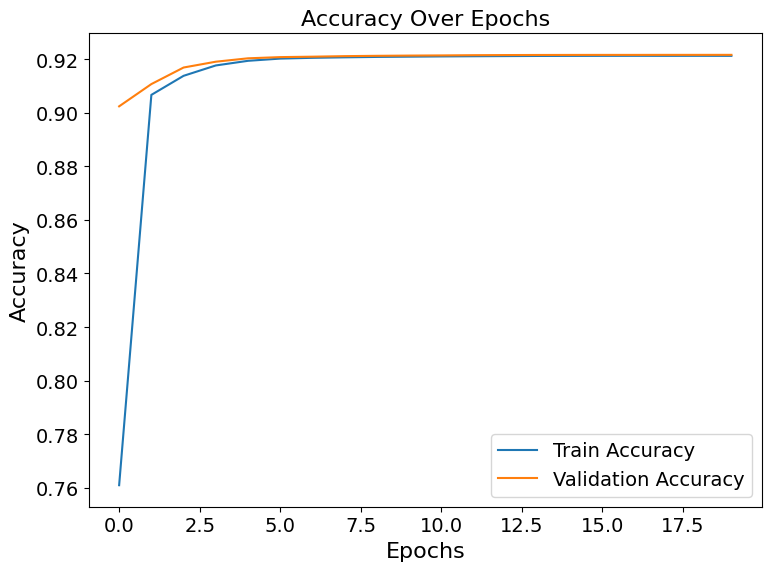

In [ ]:
# import matplotlib.pyplot as plt

# # تحديث إعدادات الرسم
# plt.rcParams.update({
#     'font.size': 16,
#     'axes.titlesize': 16,
#     'axes.labelsize': 16,
#     'xtick.labelsize': 14,
#     'ytick.labelsize': 14,
#     'legend.fontsize': 14
# })

# # رسم وحفظ رسم الدقة
# if 'accuracy' in history.history:
#     fig = plt.figure(figsize=(8, 6))
#     plt.plot(history.history['accuracy'], label='Train Accuracy')
#     plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
#     plt.xlabel('Epochs')
#     plt.ylabel('Accuracy')
#     plt.legend()
#     plt.title('Accuracy Over Epochs')
#     plt.tight_layout()

#     # حفظ الرسم كصورة بدقة 300 DPI
#     fig.savefig("accuracy.png", dpi=300)
#     print("📁 تم حفظ الرسم: accuracy.png")

#     plt.show()
# else:
#     print("⚠️ Accuracy غير موجودة في history. تم تجاوز الرسم.")


📁 تم حفظ الرسم: accuracy.png


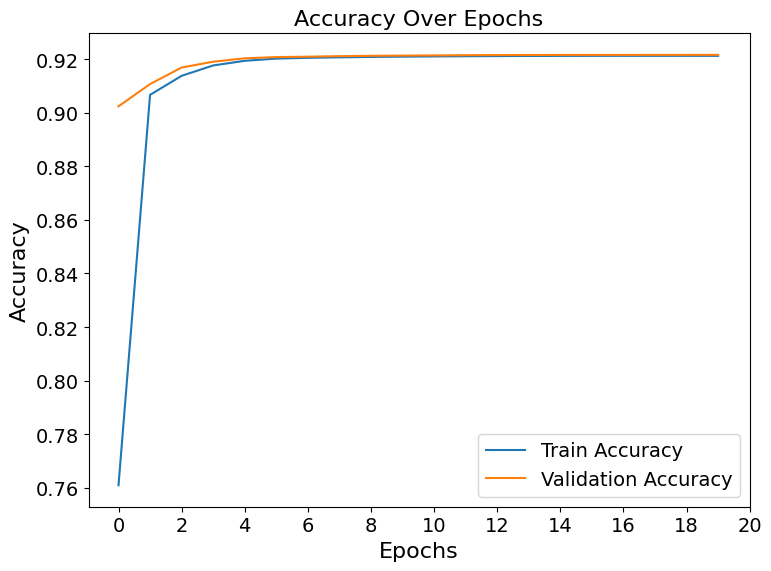

In [ ]:
import matplotlib.pyplot as plt

# تحديث إعدادات الرسم
plt.rcParams.update({
    'font.size': 16,
    'axes.titlesize': 16,
    'axes.labelsize': 16,
    'xtick.labelsize': 14,
    'ytick.labelsize': 14,
    'legend.fontsize': 14
})

# رسم وحفظ رسم الدقة
if 'accuracy' in history.history:
    fig = plt.figure(figsize=(8, 6))

    epochs = len(history.history['accuracy'])
    even_ticks = list(range(0, epochs + 1, 2))  # توليد القيم الزوجية فقط

    plt.plot(history.history['accuracy'], label='Train Accuracy')
    plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
    plt.xlabel('Epochs')
    plt.ylabel('Accuracy')
    plt.legend()
    plt.title('Accuracy Over Epochs')
    plt.xticks(ticks=even_ticks)  # تعيين القيم الزوجية كمحور X
    plt.tight_layout()

    # حفظ الرسم كصورة بدقة 300 DPI
    fig.savefig("accuracy.png", dpi=300)
    print("📁 تم حفظ الرسم: accuracy.png")

    plt.show()
else:
    print("⚠️ Accuracy غير موجودة في history. تم تجاوز الرسم.")


In [ ]:
# from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

# # Evaluate the model on the test set
# print("Evaluating on test set...")
# test_results = model.evaluate(X_test, y_test, batch_size=32, verbose=1)

# # Map test results to metric names
# test_metrics = dict(zip(model.metrics_names, test_results))

# # Print evaluation metrics
# print("\nTest Results:")
# for metric_name, value in test_metrics.items():
#     print(f"{metric_name}: {value:.4f}")

# # Compute confusion matrix
# def compute_confusion_matrix(y_true, y_pred, threshold=0.5):
#     """
#     Compute the confusion matrix for binary masks.
#     Parameters:
#     - y_true: Ground truth masks (NumPy array).
#     - y_pred: Predicted masks (NumPy array).
#     - threshold: float, threshold for binarizing predicted masks (default: 0.5).
#     Returns:
#     - Confusion matrix.
#     """
#     # Flatten arrays and apply threshold to both y_true and y_pred
#     y_true_flat = (y_true.flatten() > threshold).astype(int)  # Ensure y_true is binary
#     y_pred_flat = (y_pred.flatten() > threshold).astype(int)  # Ensure y_pred is binary

#     # Compute confusion matrix
#     return confusion_matrix(y_true_flat, y_pred_flat)

# # Predict masks for the test set and binarize the predictions
# print("Generating predictions for test set...")
# y_pred = model.predict(X_test)
# y_pred_binary = (y_pred > 0.5).astype(int)  # Convert predictions to binary (0 or 1)

# # Ensure y_test is binary
# y_test_binary = (y_test > 0.5).astype(int)  # Convert ground truth to binary

# # Compute and display confusion matrix
# conf_matrix = compute_confusion_matrix(y_test_binary, y_pred_binary)
# disp = ConfusionMatrixDisplay(confusion_matrix=conf_matrix, display_labels=["Background", "Foreground"])
# disp.plot(cmap='Blues', values_format='d')
# plt.title("Confusion Matrix")
# plt.show()

Evaluating on test set...
63/63 ━━━━━━━━━━━━━━━━━━━━ 44s 696ms/step - accuracy: 0.9205 - dice_coefficient: 0.9822 - f1_score: 0.9885 - iou: 0.9651 - loss: 0.0178 - sensitivity: 0.9882 - specificity: 0.9844

Test Results:
loss: 0.0177
compile_metrics: 0.9204
Generating predictions for test set...
63/63 ━━━━━━━━━━━━━━━━━━━━ 46s 722ms/step
✅ تم حفظ مصفوفة الالتباس: confusion_matrix.png


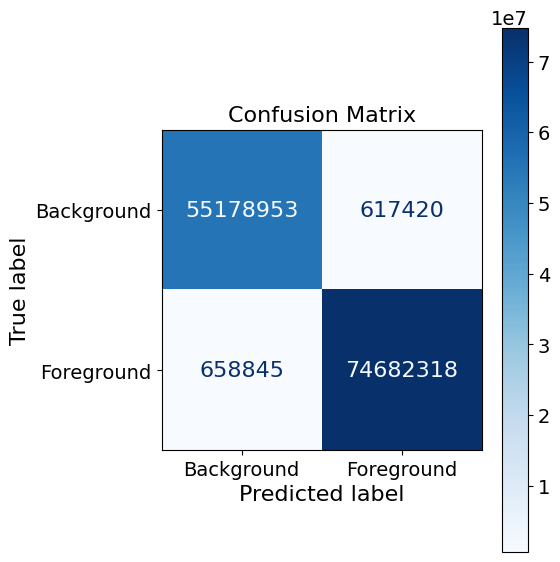

In [ ]:
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
import matplotlib.pyplot as plt

# تقييم النموذج
print("Evaluating on test set...")
test_results = model.evaluate(X_test, y_test, batch_size=32, verbose=1)
test_metrics = dict(zip(model.metrics_names, test_results))

# طباعة النتائج
print("\nTest Results:")
for metric_name, value in test_metrics.items():
    print(f"{metric_name}: {value:.4f}")

# دالة لحساب مصفوفة الالتباس
def compute_confusion_matrix(y_true, y_pred, threshold=0.5):
    y_true_flat = (y_true.flatten() > threshold).astype(int)
    y_pred_flat = (y_pred.flatten() > threshold).astype(int)
    return confusion_matrix(y_true_flat, y_pred_flat)

# التنبؤ على بيانات الاختبار
print("Generating predictions for test set...")
y_pred = model.predict(X_test)
y_pred_binary = (y_pred > 0.5).astype(int)
y_test_binary = (y_test > 0.5).astype(int)

# مصفوفة الالتباس
conf_matrix = compute_confusion_matrix(y_test_binary, y_pred_binary)

# إعدادات الخط والرسم
plt.rcParams.update({
    'font.size': 16,
    'axes.titlesize': 16,
    'axes.labelsize': 16,
    'xtick.labelsize': 14,
    'ytick.labelsize': 14,
    'legend.fontsize': 14
})

# عرض وحفظ مصفوفة الالتباس
fig, ax = plt.subplots(figsize=(6, 6))
disp = ConfusionMatrixDisplay(confusion_matrix=conf_matrix, display_labels=["Background", "Foreground"])
disp.plot(cmap='Blues', values_format='d', ax=ax)
plt.title("Confusion Matrix", fontsize=16)
plt.tight_layout()

# حفظ الصورة بدقة 300 DPI
fig.savefig("confusion_matrix.png", dpi=300)
print("✅ تم حفظ مصفوفة الالتباس: confusion_matrix.png")

plt.show()


In [ ]:
# # Function to display predictions
# def display_predictions(model, X_test, y_test, num_samples=5):
#     """
#     Display predictions alongside the ground truth masks.
#     Parameters:
#     - model: Trained model for prediction.
#     - X_test: NumPy array of test images.
#     - y_test: NumPy array of test masks.
#     - num_samples: int, number of samples to display (default: 5).
#     """
#     indices = np.random.choice(len(X_test), num_samples, replace=False)
#     plt.figure(figsize=(20, num_samples * 10))  # Adjust figsize for larger images

#     for i, idx in enumerate(indices):
#         # Get the image, ground truth, and prediction
#         image = X_test[idx]
#         true_mask = y_test[idx]
#         pred_mask = model.predict(image[np.newaxis, ...])[0]
#         pred_mask_binary = (pred_mask > 0.5).astype(np.float32)  # Threshold the prediction

#         # Plot the image
#         plt.subplot(num_samples, 3, i * 3 + 1)
#         plt.imshow(image.squeeze(), cmap='gray')
#         plt.title("Image", fontsize=20)  # Larger title font
#         plt.axis('off')

#         # Plot the ground truth mask
#         plt.subplot(num_samples, 3, i * 3 + 2)
#         plt.imshow(true_mask.squeeze(), cmap='gray')
#         plt.title("Traditional Mask", fontsize=20)  # Larger title font
#         plt.axis('off')

#         # Plot the predicted mask
#         plt.subplot(num_samples, 3, i * 3 + 3)
#         plt.imshow(pred_mask_binary.squeeze(), cmap='gray')
#         plt.title("Predicted Mask", fontsize=20)  # Larger title font
#         plt.axis('off')

#     plt.tight_layout()
#     plt.show()

# # Display predictions for random test samples
# print("Displaying predictions for random test samples...")
# display_predictions(model, X_test, y_test, num_samples=10)


Displaying predictions for random test samples...
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step
✅ Saved prediction comparison figure as: sample_predictions.png


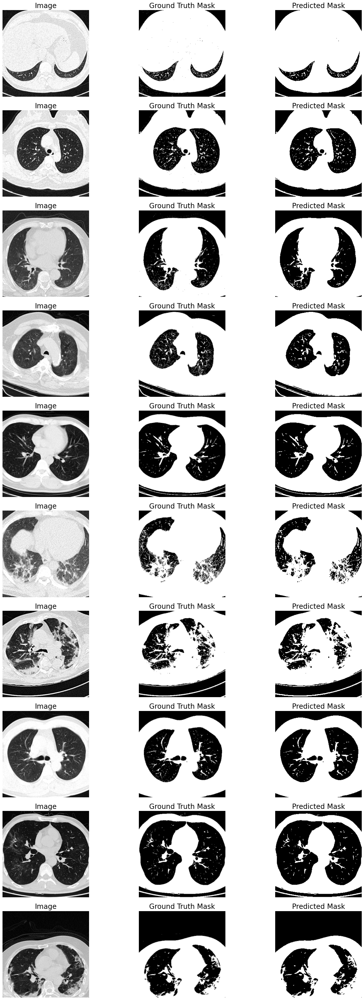

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

# دالة عرض التنبؤات مع حفظ الصورة
def display_predictions(model, X_test, y_test, num_samples=5, save_path="predictions.png"):
    """
    Display predictions alongside ground truth masks and save the figure.

    Parameters:
    - model: Trained model.
    - X_test: Test images (numpy array).
    - y_test: Ground truth masks (numpy array).
    - num_samples: Number of samples to display (default: 5).
    - save_path: Path to save the figure (default: 'predictions.png').
    """
    indices = np.random.choice(len(X_test), num_samples, replace=False)
    plt.figure(figsize=(18, num_samples * 4))

    for i, idx in enumerate(indices):
        image = X_test[idx]
        true_mask = y_test[idx]
        pred_mask = model.predict(image[np.newaxis, ...])[0]
        pred_mask_binary = (pred_mask > 0.5).astype(np.float32)

        # الصورة الأصلية
        plt.subplot(num_samples, 3, i * 3 + 1)
        plt.imshow(image.squeeze(), cmap='gray')
        plt.title("Image", fontsize=20)
        plt.axis('off')

        # القناع الحقيقي
        plt.subplot(num_samples, 3, i * 3 + 2)
        plt.imshow(true_mask.squeeze(), cmap='gray')
        plt.title("Ground Truth Mask", fontsize=20)
        plt.axis('off')

        # القناع المتوقع
        plt.subplot(num_samples, 3, i * 3 + 3)
        plt.imshow(pred_mask_binary.squeeze(), cmap='gray')
        plt.title("Predicted Mask", fontsize=20)
        plt.axis('off')

    plt.tight_layout()
    plt.savefig(save_path, dpi=300)
    print(f"✅ Saved prediction comparison figure as: {save_path}")
    plt.show()

# تنفيذ الدالة لعرض 10 عينات
print("Displaying predictions for random test samples...")
display_predictions(model, X_test, y_test, num_samples=10, save_path="sample_predictions.png")


In [ ]:
# # Function to apply edge detection
# def apply_edge_detection(mask, low_threshold=50, high_threshold=150):
#     """
#     Apply Canny Edge Detection to highlight mask edges.
#     Parameters:
#     - mask: Input mask (NumPy array, shape HxW).
#     - low_threshold: int, lower threshold for edge detection.
#     - high_threshold: int, upper threshold for edge detection.
#     Returns:
#     - Edge-detected mask as a NumPy array.
#     """
#     mask_uint8 = (mask * 255).astype(np.uint8)  # Convert mask to 8-bit for edge detection
#     edges = cv2.Canny(mask_uint8, low_threshold, high_threshold)
#     return edges

# # Function to plot histograms and overlay edges
# def plot_histograms_with_edges(images, y_true, y_pred, num_samples=5):
#     """
#     Plot histograms of pixel values with edge detection overlay.
#     Parameters:
#     - images: Original images (NumPy array, shape NxHxW).
#     - y_true: Ground truth masks (NumPy array, shape NxHxW).
#     - y_pred: Predicted masks (NumPy array, shape NxHxW).
#     - num_samples: int, number of random samples to analyze.
#     """
#     indices = np.random.choice(len(y_true), num_samples, replace=False)

#     for idx in indices:
#         original_image = images[idx].squeeze()  # Original image
#         pred_mask = y_pred[idx].squeeze()  # Predicted mask

#         # Apply edge detection
#         edge_mask = apply_edge_detection(pred_mask)

#         # Plot images and masks
#         plt.figure(figsize=(15, 6))

#         # Original Image
#         plt.subplot(1, 3, 1)
#         plt.imshow(original_image, cmap='gray')
#         plt.title("Original Image")
#         plt.axis("off")

#         # Predicted Mask
#         plt.subplot(1, 3, 2)
#         plt.imshow(pred_mask, cmap='gray')
#         plt.title("Predicted Mask")
#         plt.axis("off")

#         # Predicted Mask with Edges
#         plt.subplot(1, 3, 3)
#         plt.imshow(original_image, cmap='gray')
#         plt.imshow(edge_mask, cmap='jet', alpha=0.6)  # Overlay edges on original image
#         plt.title("Predicted Mask with Edges")
#         plt.axis("off")

#         # Plot histograms
#         plt.figure(figsize=(10, 5))
#         plt.hist(original_image.flatten(), bins=50, alpha=0.5, label="Original Image", color="blue", density=True)
#         plt.hist(pred_mask.flatten(), bins=50, alpha=0.5, label="Predicted Mask", color="orange", density=True)
#         plt.title(f"Pixel Intensity Histogram (Sample Index: {idx})")
#         plt.xlabel("Pixel Intensity")
#         plt.ylabel("Normalized Frequency")
#         plt.legend()
#         plt.tight_layout()
#         plt.show()

# # Generate predicted masks for the test set
# print("Generating predicted masks for histogram analysis...")
# y_pred_test = model.predict(X_test)
# y_pred_test = (y_pred_test > 0.5).astype(np.float32)  # Threshold predicted masks to binary

# # Plot histograms with edges using original images
# print("Plotting histograms with edge detection...")
# plot_histograms_with_edges(X_test, y_test, y_pred_test, num_samples=5)


Generating predicted masks for histogram analysis...
63/63 ━━━━━━━━━━━━━━━━━━━━ 46s 728ms/step
Plotting histograms with edge detection and saving...
✅ Saved visual comparison to: analysis_sample_visual_0.png


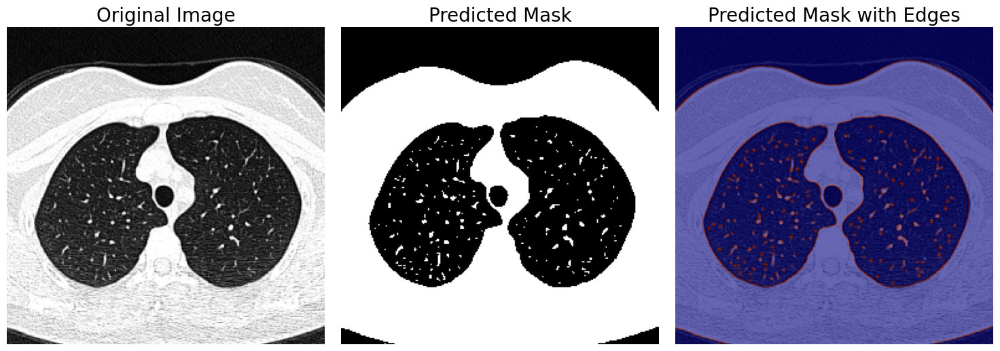

✅ Saved histogram to: analysis_sample_hist_0.png


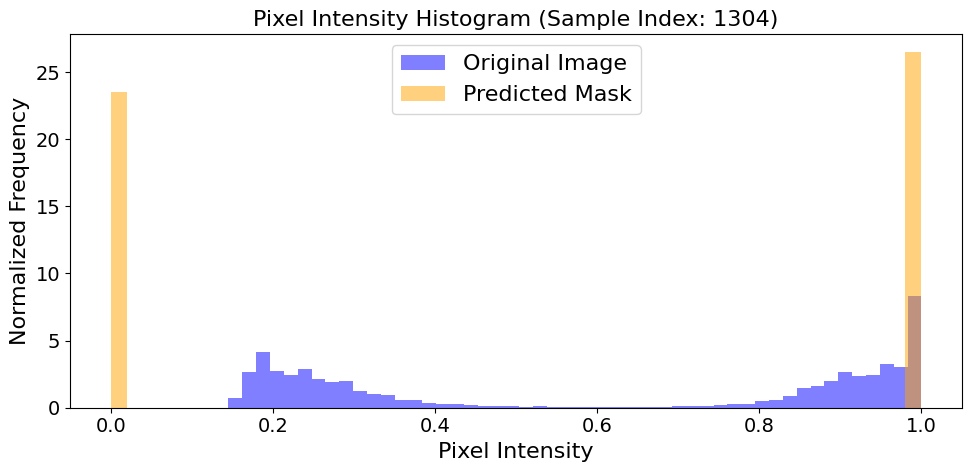

✅ Saved visual comparison to: analysis_sample_visual_1.png


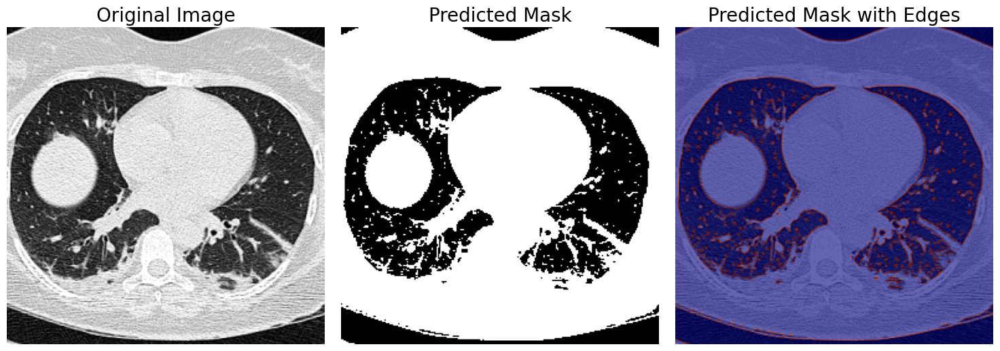

✅ Saved histogram to: analysis_sample_hist_1.png


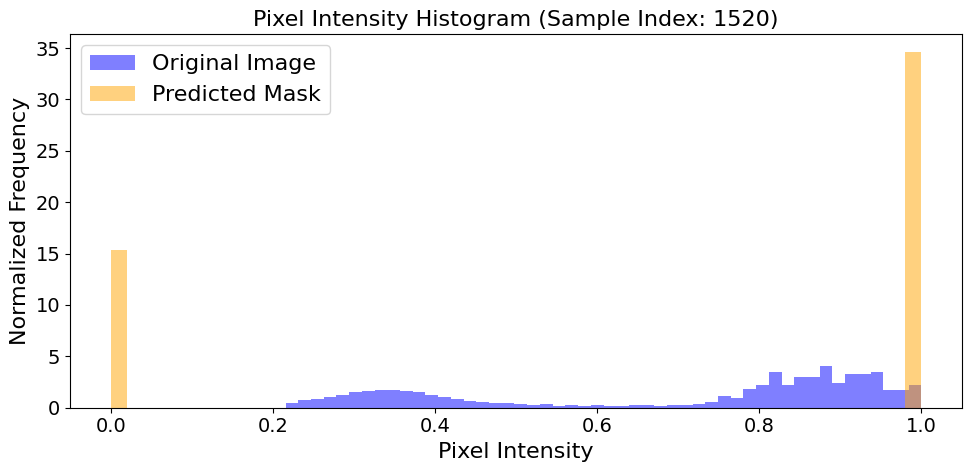

✅ Saved visual comparison to: analysis_sample_visual_2.png


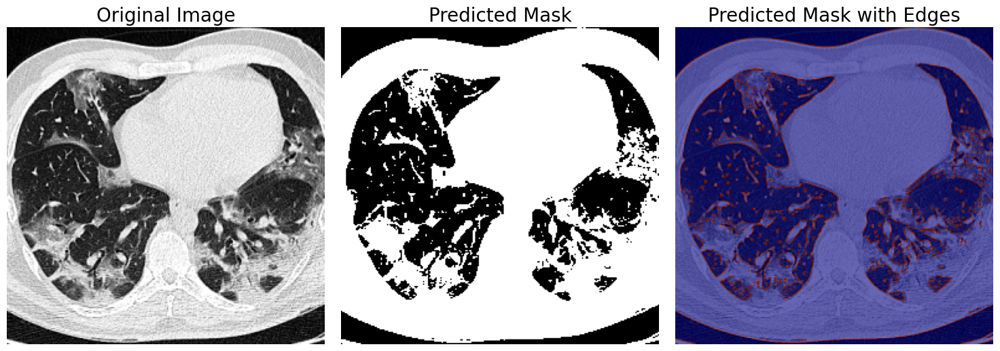

✅ Saved histogram to: analysis_sample_hist_2.png


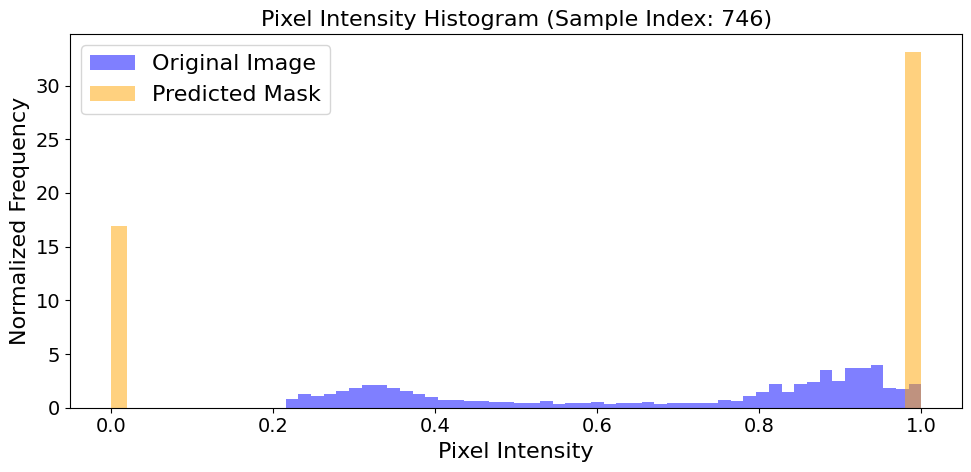

✅ Saved visual comparison to: analysis_sample_visual_3.png


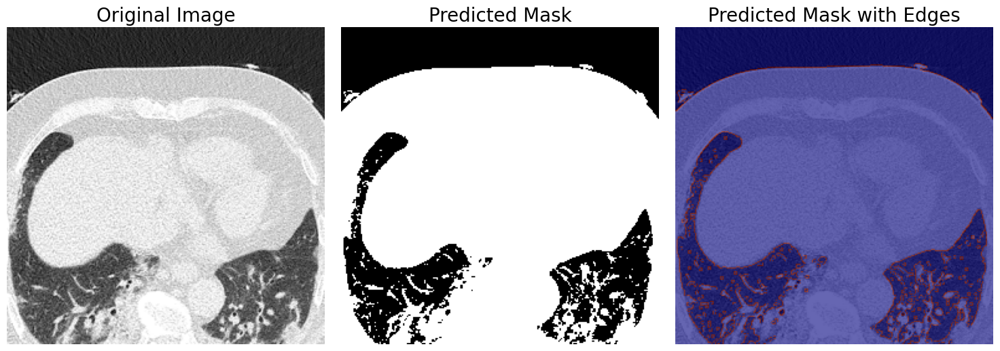

✅ Saved histogram to: analysis_sample_hist_3.png


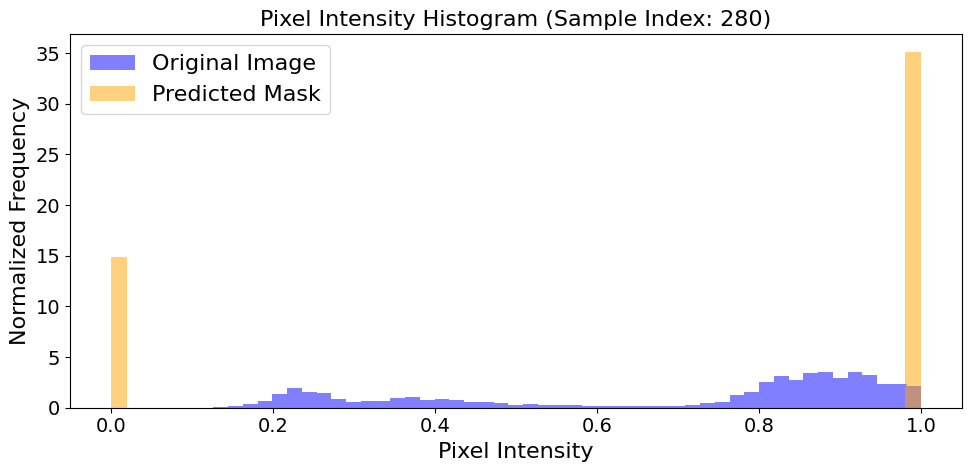

✅ Saved visual comparison to: analysis_sample_visual_4.png


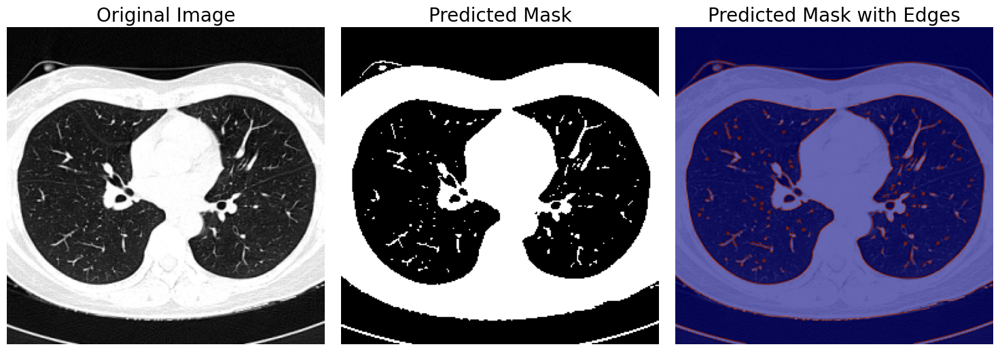

✅ Saved histogram to: analysis_sample_hist_4.png


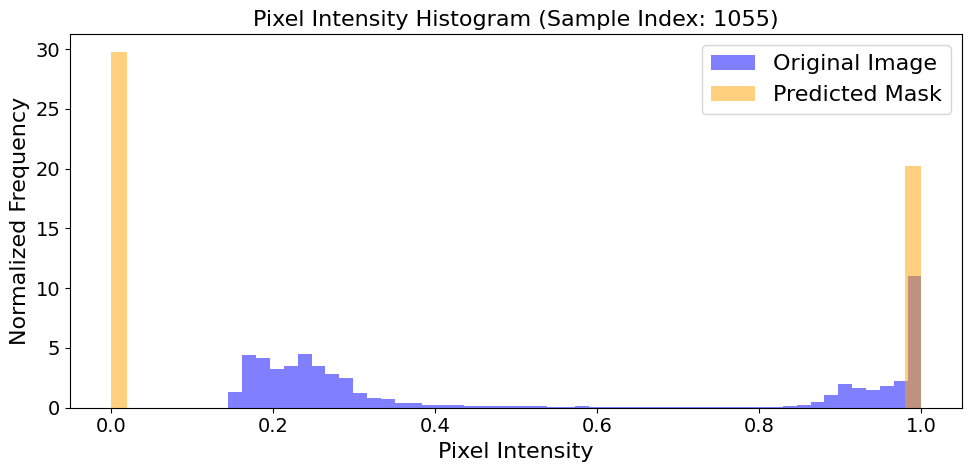

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# دالة لاكتشاف الحواف
def apply_edge_detection(mask, low_threshold=50, high_threshold=150):
    mask_uint8 = (mask * 255).astype(np.uint8)
    edges = cv2.Canny(mask_uint8, low_threshold, high_threshold)
    return edges

# دالة لعرض الصور والحواف والهيستوغرامات مع حفظ النتائج
def plot_histograms_with_edges(images, y_true, y_pred, num_samples=5, save_prefix="sample"):
    indices = np.random.choice(len(y_true), num_samples, replace=False)

    for idx_num, idx in enumerate(indices):
        original_image = images[idx].squeeze()
        pred_mask = y_pred[idx].squeeze()
        edge_mask = apply_edge_detection(pred_mask)

        # عرض الصورة، القناع، الحواف
        plt.figure(figsize=(15, 6))

        plt.subplot(1, 3, 1)
        plt.imshow(original_image, cmap='gray')
        plt.title("Original Image", fontsize=20)
        plt.axis("off")

        plt.subplot(1, 3, 2)
        plt.imshow(pred_mask, cmap='gray')
        plt.title("Predicted Mask", fontsize=20)
        plt.axis("off")

        plt.subplot(1, 3, 3)
        plt.imshow(original_image, cmap='gray')
        plt.imshow(edge_mask, cmap='jet', alpha=0.6)
        plt.title("Predicted Mask with Edges", fontsize=20)
        plt.axis("off")

        plt.tight_layout()
        img_filename = f"{save_prefix}_visual_{idx_num}.png"
        plt.savefig(img_filename, dpi=300)
        print(f"✅ Saved visual comparison to: {img_filename}")
        plt.show()

        # رسم الهيستوغرامات
        plt.figure(figsize=(10, 5))
        plt.hist(original_image.flatten(), bins=50, alpha=0.5, label="Original Image", color="blue", density=True)
        plt.hist(pred_mask.flatten(), bins=50, alpha=0.5, label="Predicted Mask", color="orange", density=True)
        plt.title(f"Pixel Intensity Histogram (Sample Index: {idx})", fontsize=16)
        plt.xlabel("Pixel Intensity", fontsize=16)
        plt.ylabel("Normalized Frequency", fontsize=16)
        plt.legend(fontsize=16)
        plt.tight_layout()
        hist_filename = f"{save_prefix}_hist_{idx_num}.png"
        plt.savefig(hist_filename, dpi=300)
        print(f"✅ Saved histogram to: {hist_filename}")
        plt.show()

# تنفيذ
print("Generating predicted masks for histogram analysis...")
y_pred_test = model.predict(X_test)
y_pred_test = (y_pred_test > 0.5).astype(np.float32)

print("Plotting histograms with edge detection and saving...")
plot_histograms_with_edges(X_test, y_test, y_pred_test, num_samples=5, save_prefix="analysis_sample")


In [ ]:
# # Evaluate the model on the test data
# print("Evaluating the model on test data...")
# test_results = model.evaluate(X_test, y_test, verbose=1)

# # Print the number of returned values
# print(f"Number of returned values: {len(test_results)}")
# print(f"Returned values: {test_results}")

# # Map test results to metric names for debugging
# for name, value in zip(model.metrics_names, test_results):
#     print(f"{name}: {value:.4f}")


In [ ]:
# # Evaluate the model
# print("Evaluating the model on test data...")
# test_results = model.evaluate(X_test, y_test, verbose=1)

# # Dynamically create a dictionary mapping metric names to values
# test_metrics = dict(zip(model.metrics_names, test_results))

# # Display results
# print("\nTest Results Summary:")
# for metric_name, metric_value in test_metrics.items():
#     print(f"{metric_name}: {metric_value:.4f}")


In [ ]:
# Evaluate the model on the test data
print("Evaluating the model on test data...")
test_results = model.evaluate(X_test, y_test, verbose=1)

# Dynamically map test results to metric names
test_metrics = dict(zip(model.metrics_names, test_results))

# Final results summary function
def display_results_summary(test_metrics):
    """
    Display a summary of the final test results.
    Parameters:
    - test_metrics: Dictionary containing test metric names and their values.
    """
    print("\nFinal Results Summary:")
    for metric_name, metric_value in test_metrics.items():
        print(f"{metric_name}: {metric_value:.4f}")
    print("Grad-CAM++ analysis and histogram visualizations completed successfully!")

# Display the final results summary
display_results_summary(test_metrics)


Evaluating the model on test data...
63/63 ━━━━━━━━━━━━━━━━━━━━ 45s 716ms/step - accuracy: 0.9205 - dice_coefficient: 0.9822 - f1_score: 0.9885 - iou: 0.9651 - loss: 0.0178 - sensitivity: 0.9882 - specificity: 0.9844

Final Results Summary:
loss: 0.0177
compile_metrics: 0.9204
Grad-CAM++ analysis and histogram visualizations completed successfully!


In [ ]:
# # Evaluate the model on the test data
# print("Evaluating the model on test data...")
# test_results = model.evaluate(X_test, y_test, verbose=1)

# # Dynamically map test results to metric names (including accuracy)
# test_metrics = dict(zip(model.metrics_names, test_results))

# # Final results summary function
# def display_results_summary(test_metrics):
#     """
#     Display a summary of the final test results.
#     Parameters:
#     - test_metrics: Dictionary containing test metric names and their values.
#     """
#     print("\nFinal Results Summary:")
#     for metric_name, metric_value in test_metrics.items():
#         print(f"{metric_name}: {metric_value:.4f}")
#     print("\nGrad-CAM++ analysis and histogram visualizations completed successfully!")

# # Display the final results summary
# display_results_summary(test_metrics)

# # Show accuracy separately
# if "accuracy" in test_metrics:
#     print(f"\n✅ Model Accuracy: {test_metrics['accuracy']:.4f}")
# else:
#     print("\n⚠️ Accuracy metric was not found in the model evaluation output.")


In [ ]:
# # Evaluate the model on the test data
# print("Evaluating the model on test data...")
# test_loss, test_dice, test_iou, test_f1, test_sensitivity, test_specificity = model.evaluate(X_test, y_test, verbose=1)

# # Map test results to metric names
# test_metrics = {
#     "Test Loss": test_loss,
#     "Test Dice Coefficient": test_dice,
#     "Test IoU": test_iou,
#     "Test F1-Score": test_f1,
#     "Test Sensitivity": test_sensitivity,
#     "Test Specificity": test_specificity,
# }

# # Final results summary
# def display_results_summary(test_metrics):
#     """
#     Display a summary of the final test results.
#     Parameters:
#     - test_metrics: Dictionary containing test metric names and their values.
#     """
#     print("\nFinal Results Summary:")
#     for metric_name, metric_value in test_metrics.items():
#         print(f"{metric_name}: {metric_value:.4f}")
#     print("Grad-CAM++ analysis and histogram visualizations completed successfully!")

# # Display the final results summary
# display_results_summary(test_metrics)


# Heatmap

In [ ]:
for layer in model.layers:
    print(layer.name)


input_layer_1
conv2d_10
global_average_pooling2d_7
dense_14
dense_15
multiply_7
max_pooling2d_4
conv2d_11
global_average_pooling2d_8
dense_16
dense_17
multiply_8
max_pooling2d_5
conv2d_12
global_average_pooling2d_9
dense_18
dense_19
multiply_9
max_pooling2d_6
conv2d_13
max_pooling2d_7
conv2d_14
global_average_pooling2d_10
dense_20
dense_21
multiply_10
conv2d_transpose_4
concatenate_4
conv2d_15
conv2d_transpose_5
concatenate_5
conv2d_16
global_average_pooling2d_11
dense_22
dense_23
multiply_11
conv2d_transpose_6
concatenate_6
conv2d_17
global_average_pooling2d_12
dense_24
dense_25
multiply_12
conv2d_transpose_7
concatenate_7
conv2d_18
global_average_pooling2d_13
dense_26
dense_27
multiply_13
conv2d_19


In [ ]:
# from tensorflow.keras import backend as K

# # Function to calculate Grad-CAM++ for a specific layer
# def grad_cam_plus_plus(model, image, layer_name):
#     """
#     Generate a Grad-CAM++ heatmap for a single layer.
#     Parameters:
#     - model: Trained model.
#     - image: Input image (NumPy array, shape HxW or HxWxC).
#     - layer_name: Name of the convolutional layer to analyze.
#     Returns:
#     - Normalized Grad-CAM++ heatmap (NumPy array, shape HxW).
#     """
#     grad_model = tf.keras.models.Model(
#         inputs=[model.inputs],
#         outputs=[model.get_layer(layer_name).output, model.output]
#     )
#     image_expanded = np.expand_dims(image, axis=0)

#     with tf.GradientTape() as tape:
#         conv_output, predictions = grad_model(image_expanded)
#         loss = tf.reduce_mean(predictions)

#     gradients = tape.gradient(loss, conv_output)
#     weights = tf.reduce_mean(gradients, axis=(0, 1, 2))
#     activation_map = conv_output[0]
#     grad_cam = tf.reduce_sum(tf.multiply(weights, activation_map), axis=-1)

#     # Normalize and apply ReLU
#     heatmap = np.maximum(grad_cam, 0)
#     heatmap = heatmap / np.max(heatmap) if np.max(heatmap) != 0 else heatmap

#     return heatmap

# # Combine Grad-CAM++ for multiple layers
# def combined_grad_cam(model, image, layers):
#     """
#     Combine Grad-CAM++ heatmaps from multiple layers.
#     Parameters:
#     - model: Trained model.
#     - image: Input image (NumPy array, shape HxW or HxWxC).
#     - layers: List of layer names to analyze.
#     Returns:
#     - Combined normalized heatmap (NumPy array, shape HxW).
#     """
#     combined_heatmap = np.zeros((image.shape[0], image.shape[1]), dtype=np.float32)
#     for layer_name in layers:
#         heatmap = grad_cam_plus_plus(model, image, layer_name)
#         heatmap_resized = cv2.resize(heatmap, (image.shape[1], image.shape[0]))
#         combined_heatmap += heatmap_resized

#     combined_heatmap = combined_heatmap / np.max(combined_heatmap)
#     return combined_heatmap

# # Display results
# def display_combined_grad_cam_results(model, X_test, layers, num_samples=5):
#     """
#     Display Grad-CAM++ heatmaps for multiple test images.
#     Parameters:
#     - model: Trained model.
#     - X_test: Test dataset (NumPy array, shape NxHxW or NxHxWxC).
#     - layers: List of layer names to analyze.
#     - num_samples: Number of test samples to visualize.
#     """
#     indices = np.random.choice(len(X_test), num_samples, replace=False)
#     plt.figure(figsize=(15, num_samples * 5))

#     for i, idx in enumerate(indices):
#         image = X_test[idx]
#         combined_heatmap = combined_grad_cam(model, image, layers)

#         # Normalize and create heatmap overlay
#         heatmap = (combined_heatmap * 255).astype(np.uint8)
#         heatmap_colormap = cv2.applyColorMap(heatmap, cv2.COLORMAP_JET)
#         overlay = cv2.addWeighted(
#             cv2.cvtColor((image.squeeze() * 255).astype(np.uint8), cv2.COLOR_GRAY2BGR),
#             0.6, heatmap_colormap, 0.4, 0
#         )

#         # Display original image
#         plt.subplot(num_samples, 3, i * 3 + 1)
#         plt.imshow(image.squeeze(), cmap='gray')
#         plt.title("Original Image")
#         plt.axis('off')

#         # Display combined heatmap
#         plt.subplot(num_samples, 3, i * 3 + 2)
#         plt.imshow(heatmap_colormap)
#         plt.title("Combined Heatmap")
#         plt.axis('off')

#         # Display overlay
#         plt.subplot(num_samples, 3, i * 3 + 3)
#         plt.imshow(overlay)
#         plt.title("Overlay")
#         plt.axis('off')

#     plt.tight_layout()
#     plt.show()

# # تعديل قائمة الطبقات بناءً على الأسماء الصحيحة
# layers_to_combine = ["conv2d_35", "conv2d_36", "conv2d_37"]

# # Generate and display combined Grad-CAM++ results
# print(f"Generating combined Grad-CAM++ results for layers: {layers_to_combine}")
# display_combined_grad_cam_results(model, X_test, layers=layers_to_combine, num_samples=5)


Generating combined Grad-CAM++ results for layers: ['conv2d_10', 'conv2d_13', 'conv2d_19']
✅ Saved Grad-CAM++ visualization to: gradcam_sample_0.png


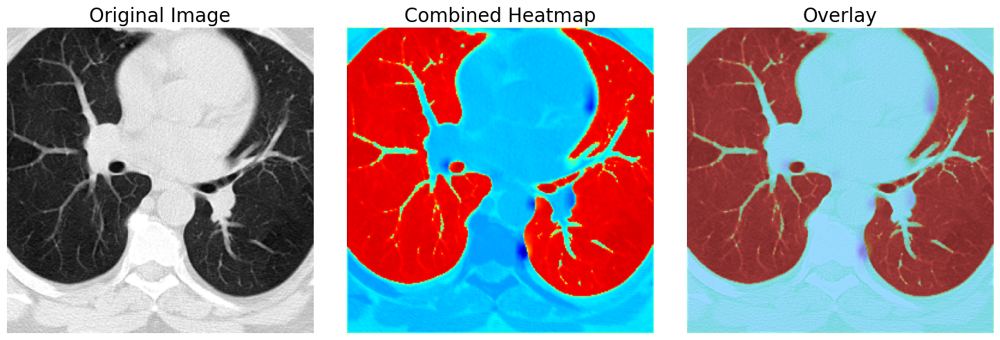

✅ Saved Grad-CAM++ visualization to: gradcam_sample_1.png


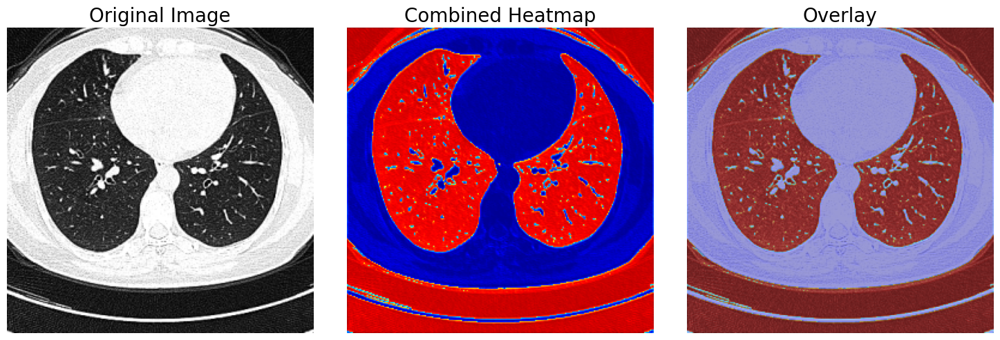

✅ Saved Grad-CAM++ visualization to: gradcam_sample_2.png


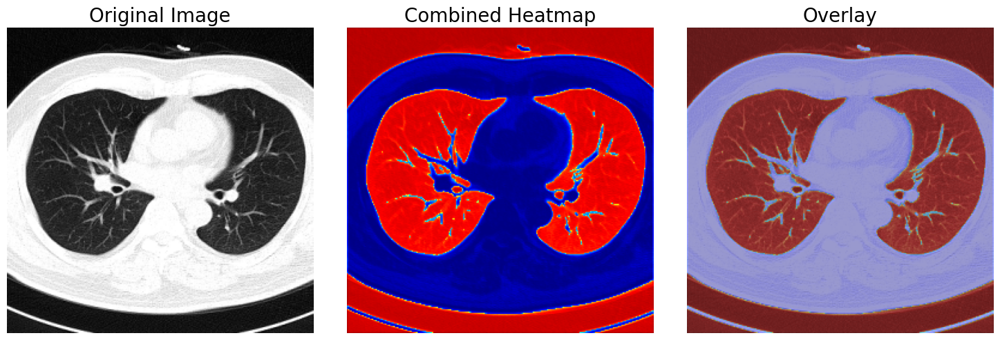

✅ Saved Grad-CAM++ visualization to: gradcam_sample_3.png


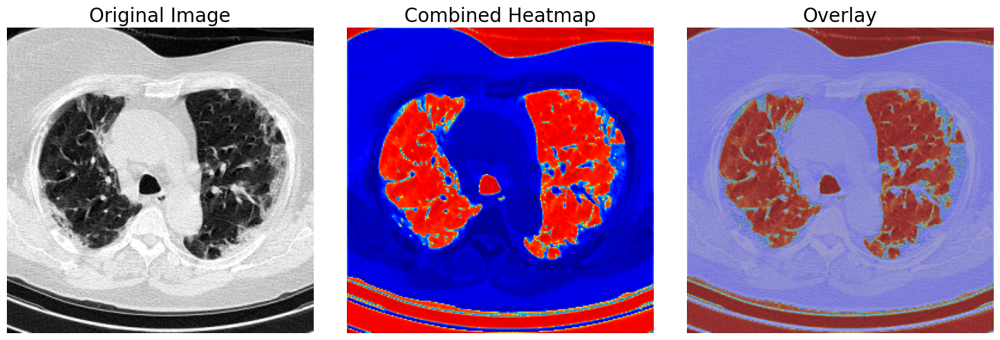

✅ Saved Grad-CAM++ visualization to: gradcam_sample_4.png


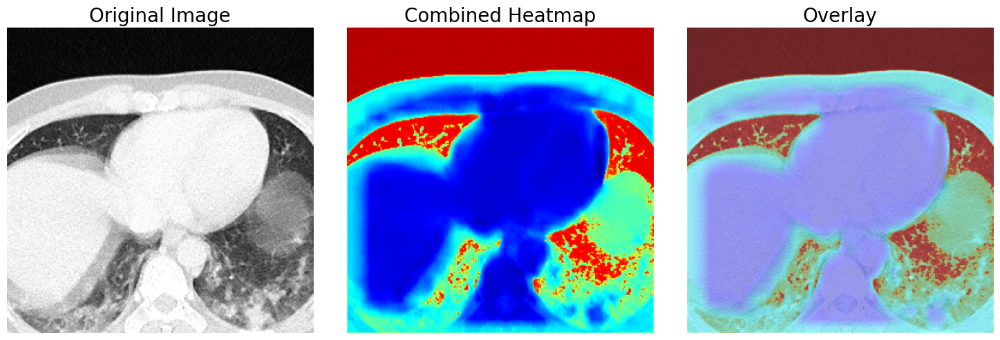

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf
import cv2
from tensorflow.keras import backend as K

# Grad-CAM++ for a single layer
def grad_cam_plus_plus(model, image, layer_name):
    grad_model = tf.keras.models.Model(
        inputs=[model.inputs],
        outputs=[model.get_layer(layer_name).output, model.output]
    )
    image_expanded = np.expand_dims(image, axis=0)

    with tf.GradientTape() as tape:
        conv_output, predictions = grad_model(image_expanded)
        loss = tf.reduce_mean(predictions)

    gradients = tape.gradient(loss, conv_output)
    weights = tf.reduce_mean(gradients, axis=(0, 1, 2))
    activation_map = conv_output[0]
    grad_cam = tf.reduce_sum(tf.multiply(weights, activation_map), axis=-1)

    heatmap = np.maximum(grad_cam, 0)
    heatmap = heatmap / np.max(heatmap) if np.max(heatmap) != 0 else heatmap
    return heatmap

# Combine Grad-CAM++ heatmaps from multiple layers
def combined_grad_cam(model, image, layers):
    combined_heatmap = np.zeros((image.shape[0], image.shape[1]), dtype=np.float32)
    for layer_name in layers:
        heatmap = grad_cam_plus_plus(model, image, layer_name)
        heatmap_resized = cv2.resize(heatmap, (image.shape[1], image.shape[0]))
        combined_heatmap += heatmap_resized

    combined_heatmap = combined_heatmap / np.max(combined_heatmap) if np.max(combined_heatmap) != 0 else combined_heatmap
    return combined_heatmap

# Display and save Grad-CAM++ results
def display_combined_grad_cam_results(model, X_test, layers, num_samples=5, save_prefix="gradcam"):
    indices = np.random.choice(len(X_test), num_samples, replace=False)

    for i, idx in enumerate(indices):
        image = X_test[idx]
        combined_heatmap = combined_grad_cam(model, image, layers)

        # Convert heatmap to color
        heatmap = (combined_heatmap * 255).astype(np.uint8)
        heatmap_colormap = cv2.applyColorMap(heatmap, cv2.COLORMAP_JET)

        # Convert grayscale image to BGR for overlay
        original_uint8 = (image.squeeze() * 255).astype(np.uint8)
        if len(original_uint8.shape) == 2:
            original_bgr = cv2.cvtColor(original_uint8, cv2.COLOR_GRAY2BGR)
        else:
            original_bgr = original_uint8

        overlay = cv2.addWeighted(original_bgr, 0.6, heatmap_colormap, 0.4, 0)

        # Plot results
        plt.figure(figsize=(15, 5))

        plt.subplot(1, 3, 1)
        plt.imshow(image.squeeze(), cmap='gray')
        plt.title("Original Image", fontsize=20)
        plt.axis('off')

        plt.subplot(1, 3, 2)
        plt.imshow(heatmap_colormap)
        plt.title("Combined Heatmap", fontsize=20)
        plt.axis('off')

        plt.subplot(1, 3, 3)
        plt.imshow(overlay)
        plt.title("Overlay", fontsize=20)
        plt.axis('off')

        plt.tight_layout()

        # Save result
        filename = f"{save_prefix}_sample_{i}.png"
        plt.savefig(filename, dpi=300)
        print(f"✅ Saved Grad-CAM++ visualization to: {filename}")
        plt.show()

# Use actual existing convolutional layers from your model
layers_to_combine = ["conv2d_10", "conv2d_13", "conv2d_19"]

# Run visualization
print(f"Generating combined Grad-CAM++ results for layers: {layers_to_combine}")
display_combined_grad_cam_results(model, X_test, layers=layers_to_combine, num_samples=5, save_prefix="gradcam")


In [ ]:
# # Freeze all layers except the last few
# num_layers_to_unfreeze = 5  # Number of layers to keep trainable
# for layer in model.layers[:-num_layers_to_unfreeze]:
#     layer.trainable = False

# # Compile the model with a lower learning rate
# model.compile(
#     optimizer=tf.keras.optimizers.Adam(learning_rate=1e-5),
#     loss=dice_loss,
#     metrics=[dice_coefficient, iou]
# )

# # Fine-tune the model on the training data
# fine_tune_epochs = 2  # Number of fine-tuning epochs
# print("\nFine-tuning the model on the last layers...")
# fine_tune_history = model.fit(
#     X_train, y_train,
#     validation_data=(X_val, y_val),
#     epochs=fine_tune_epochs,
#     batch_size=32,
#     verbose=1
# )
# print("\nFine-tuning complete.")

# # Display fine-tuning results
# print("\nFine-tuning results summary:")
# for metric, values in fine_tune_history.history.items():
#     if 'val_' in metric:  # Only display validation metrics
#         print(f"{metric}: {values[-1]:.4f}")


In [ ]:
# Freeze all layers except the last few
num_layers_to_unfreeze = 5  # Number of layers to keep trainable
for layer in model.layers[:-num_layers_to_unfreeze]:
    layer.trainable = False

# Compile the model with a lower learning rate and include accuracy
model.compile(
optimizer=tf.keras.optimizers.Adam(learning_rate=1e-5),
    loss=dice_loss,
    metrics=[accuracy, dice_coefficient, iou]  # Added accuracy
)

# Fine-tune the model on the training data
fine_tune_epochs = 2  # Number of fine-tuning epochs
print("\nFine-tuning the model on the last layers...")
fine_tune_history = model.fit(
    X_train, y_train,
    validation_data=(X_val, y_val),
    epochs=fine_tune_epochs,
    batch_size=32,
    verbose=1
)
print("\nFine-tuning complete.")

# Display fine-tuning results
print("\nFine-tuning results summary:")
for metric, values in fine_tune_history.history.items():
    if 'val_' in metric:  # Display only validation metrics
        print(f"{metric}: {values[-1]:.4f}")

# Display final fine-tuned accuracy
if "val_accuracy" in fine_tune_history.history:
    print(f"\n✅ Fine-Tuned Model Accuracy: {fine_tune_history.history['val_accuracy'][-1]:.4f}")
else:
    print("\n⚠️ Accuracy metric was not found in fine-tuning results.")



Fine-tuning the model on the last layers...
Epoch 1/2
438/438 ━━━━━━━━━━━━━━━━━━━━ 450s 1s/step - accuracy: 0.9215 - dice_coefficient: 0.9824 - iou: 0.9655 - loss: 0.0176 - val_accuracy: 0.9216 - val_dice_coefficient: 0.9824 - val_iou: 0.9655 - val_loss: 0.0176
Epoch 2/2
438/438 ━━━━━━━━━━━━━━━━━━━━ 443s 1s/step - accuracy: 0.9214 - dice_coefficient: 0.9824 - iou: 0.9654 - loss: 0.0176 - val_accuracy: 0.9216 - val_dice_coefficient: 0.9824 - val_iou: 0.9655 - val_loss: 0.0176

Fine-tuning complete.

Fine-tuning results summary:
val_accuracy: 0.9216
val_dice_coefficient: 0.9824
val_iou: 0.9655
val_loss: 0.0176

✅ Fine-Tuned Model Accuracy: 0.9216


In [ ]:
# Evaluate the model on test data
print("Evaluating the model on test data...")
test_results = model.evaluate(X_test, y_test, verbose=1)

# Map test results to metric names for better readability
test_metrics = dict(zip(model.metrics_names, test_results))

# Print evaluation results
print("\nTest Results Summary:")
for metric_name, value in test_metrics.items():
    print(f"{metric_name}: {value:.4f}")


Evaluating the model on test data...
63/63 ━━━━━━━━━━━━━━━━━━━━ 44s 689ms/step - accuracy: 0.9205 - dice_coefficient: 0.9823 - iou: 0.9651 - loss: 0.0177

Test Results Summary:
loss: 0.0177
compile_metrics: 0.9204


In [ ]:
from tensorflow.keras import backend as K

# Function to calculate Grad-CAM++ for a specific layer
def grad_cam_plus_plus(model, image, layer_name):
    """
    Generate a Grad-CAM++ heatmap for a single layer.
    Parameters:
    - model: Trained model.
    - image: Input image (NumPy array, shape HxW or HxWxC).
    - layer_name: Name of the convolutional layer to analyze.
    Returns:
    - Normalized Grad-CAM++ heatmap (NumPy array, shape HxW).
    """
    grad_model = tf.keras.models.Model(
        inputs=[model.inputs],
        outputs=[model.get_layer(layer_name).output, model.output]
    )
    image_expanded = np.expand_dims(image, axis=0)

    with tf.GradientTape() as tape:
        conv_output, predictions = grad_model(image_expanded)
        loss = tf.reduce_mean(predictions)

    gradients = tape.gradient(loss, conv_output)
    weights = tf.reduce_mean(gradients, axis=(0, 1, 2))
    activation_map = conv_output[0]
    grad_cam = tf.reduce_sum(tf.multiply(weights, activation_map), axis=-1)

    # Normalize and apply ReLU
    heatmap = np.maximum(grad_cam, 0)
    heatmap = heatmap / np.max(heatmap) if np.max(heatmap) != 0 else heatmap

    return heatmap

# Combine Grad-CAM++ for multiple layers
def combined_grad_cam(model, image, layers):
    """
    Combine Grad-CAM++ heatmaps from multiple layers.
    Parameters:
    - model: Trained model.
    - image: Input image (NumPy array, shape HxW or HxWxC).
    - layers: List of layer names to analyze.
    Returns:
    - Combined normalized heatmap (NumPy array, shape HxW).
    """
    combined_heatmap = np.zeros((image.shape[0], image.shape[1]), dtype=np.float32)
    for layer_name in layers:
        heatmap = grad_cam_plus_plus(model, image, layer_name)
        heatmap_resized = cv2.resize(heatmap, (image.shape[1], image.shape[0]))
        combined_heatmap += heatmap_resized

    combined_heatmap = combined_heatmap / np.max(combined_heatmap)
    return combined_heatmap

# Display Grad-CAM++ results
def display_combined_grad_cam_results(model, X_test, layers, num_samples=5):
    """
    Display Grad-CAM++ heatmaps for multiple test images.
    Parameters:
    - model: Trained model.
    - X_test: Test dataset (NumPy array, shape NxHxW or NxHxWxC).
    - layers: List of layer names to analyze.
    - num_samples: Number of test samples to visualize.
    """
    indices = np.random.choice(len(X_test), num_samples, replace=False)
    plt.figure(figsize=(15, num_samples * 5))

    for i, idx in enumerate(indices):
        image = X_test[idx]
        combined_heatmap = combined_grad_cam(model, image, layers)

        # Normalize and create heatmap overlay
        heatmap = (combined_heatmap * 255).astype(np.uint8)
        heatmap_colormap = cv2.applyColorMap(heatmap, cv2.COLORMAP_JET)
        overlay = cv2.addWeighted(
            cv2.cvtColor((image.squeeze() * 255).astype(np.uint8), cv2.COLOR_GRAY2BGR),
            0.6, heatmap_colormap, 0.4, 0
        )

        # Display original image
        plt.subplot(num_samples, 3, i * 3 + 1)
        plt.imshow(image.squeeze(), cmap='gray')
        plt.title("Original Image")
        plt.axis('off')

        # Display combined heatmap
        plt.subplot(num_samples, 3, i * 3 + 2)
        plt.imshow(heatmap_colormap)
        plt.title("Combined Heatmap")
        plt.axis('off')

        # Display overlay
        plt.subplot(num_samples, 3, i * 3 + 3)
        plt.imshow(overlay)
        plt.title("Overlay")
        plt.axis('off')

    plt.tight_layout()
    plt.show()



# Specify layers to combine
layers_to_combine = ["conv2d_35", "conv2d_36", "conv2d_37"]

# Generate and display combined Grad-CAM++ results
print(f"Generating combined Grad-CAM++ results for layers: {layers_to_combine}")
display_combined_grad_cam_results(model, X_test, layers=layers_to_combine, num_samples=5)


Generating combined Grad-CAM++ results for layers: ['conv2d_35', 'conv2d_36', 'conv2d_37']


ValueError: No such layer: conv2d_35. Existing layers are: ['input_layer_1', 'conv2d_10', 'global_average_pooling2d_7', 'dense_14', 'dense_15', 'multiply_7', 'max_pooling2d_4', 'conv2d_11', 'global_average_pooling2d_8', 'dense_16', 'dense_17', 'multiply_8', 'max_pooling2d_5', 'conv2d_12', 'global_average_pooling2d_9', 'dense_18', 'dense_19', 'multiply_9', 'max_pooling2d_6', 'conv2d_13', 'max_pooling2d_7', 'conv2d_14', 'global_average_pooling2d_10', 'dense_20', 'dense_21', 'multiply_10', 'conv2d_transpose_4', 'concatenate_4', 'conv2d_15', 'conv2d_transpose_5', 'concatenate_5', 'conv2d_16', 'global_average_pooling2d_11', 'dense_22', 'dense_23', 'multiply_11', 'conv2d_transpose_6', 'concatenate_6', 'conv2d_17', 'global_average_pooling2d_12', 'dense_24', 'dense_25', 'multiply_12', 'conv2d_transpose_7', 'concatenate_7', 'conv2d_18', 'global_average_pooling2d_13', 'dense_26', 'dense_27', 'multiply_13', 'conv2d_19'].

<Figure size 1500x2500 with 0 Axes>

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf
import cv2
from tensorflow.keras import backend as K

# Grad-CAM++ for a single layer
def grad_cam_plus_plus(model, image, layer_name):
    grad_model = tf.keras.models.Model(
        inputs=[model.inputs],
        outputs=[model.get_layer(layer_name).output, model.output]
    )
    image_expanded = np.expand_dims(image, axis=0)

    with tf.GradientTape() as tape:
        conv_output, predictions = grad_model(image_expanded)
        loss = tf.reduce_mean(predictions)

    gradients = tape.gradient(loss, conv_output)
    weights = tf.reduce_mean(gradients, axis=(0, 1, 2))
    activation_map = conv_output[0]
    grad_cam = tf.reduce_sum(tf.multiply(weights, activation_map), axis=-1)

    heatmap = np.maximum(grad_cam, 0)
    heatmap = heatmap / np.max(heatmap) if np.max(heatmap) != 0 else heatmap

    return heatmap

# Combine multiple Grad-CAM++ maps
def combined_grad_cam(model, image, layers):
    combined_heatmap = np.zeros((image.shape[0], image.shape[1]), dtype=np.float32)
    for layer_name in layers:
        heatmap = grad_cam_plus_plus(model, image, layer_name)
        heatmap_resized = cv2.resize(heatmap, (image.shape[1], image.shape[0]))
        combined_heatmap += heatmap_resized

    combined_heatmap = combined_heatmap / np.max(combined_heatmap) if np.max(combined_heatmap) != 0 else combined_heatmap
    return combined_heatmap

# Display and save results
def display_combined_grad_cam_results(model, X_test, layers, num_samples=5, save_prefix="gradcam"):
    indices = np.random.choice(len(X_test), num_samples, replace=False)

    for i, idx in enumerate(indices):
        image = X_test[idx]
        combined_heatmap = combined_grad_cam(model, image, layers)

        heatmap = (combined_heatmap * 255).astype(np.uint8)
        heatmap_colormap = cv2.applyColorMap(heatmap, cv2.COLORMAP_JET)

        original_uint8 = (image.squeeze() * 255).astype(np.uint8)
        if len(original_uint8.shape) == 2:
            original_bgr = cv2.cvtColor(original_uint8, cv2.COLOR_GRAY2BGR)
        else:
            original_bgr = original_uint8

        overlay = cv2.addWeighted(original_bgr, 0.6, heatmap_colormap, 0.4, 0)

        # Display
        plt.figure(figsize=(15, 5))

        plt.subplot(1, 3, 1)
        plt.imshow(image.squeeze(), cmap='gray')
        plt.title("Original Image", fontsize=20)
        plt.axis('off')

        plt.subplot(1, 3, 2)
        plt.imshow(heatmap_colormap)
        plt.title("Combined Heatmap", fontsize=20)
        plt.axis('off')

        plt.subplot(1, 3, 3)
        plt.imshow(overlay)
        plt.title("Overlay", fontsize=20)
        plt.axis('off')

        plt.tight_layout()

        # Save figure
        layer_str = "_".join(layers)
        filename = f"{save_prefix}_sample_{i}_layers_{layer_str}.png"
        plt.savefig(filename, dpi=300)
        print(f"✅ Saved: {filename}")
        plt.show()

# استخدام الطبقات المطلوبة
layers_to_combine = ["conv2d_35", "conv2d_36", "conv2d_37"]

# تنفيذ العرض والحفظ
print(f"Generating combined Grad-CAM++ results for layers: {layers_to_combine}")
display_combined_grad_cam_results(model, X_test, layers=layers_to_combine, num_samples=5)
